In [ ]:
# Kütüphaneler
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
import seaborn as sns
from skimage import io
import cv2
sns.set()

In [ ]:
!git clone https://github.com/hardik0/AI-for-Medicine-Specialization
%cd AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/

Cloning into 'AI-for-Medicine-Specialization'...
remote: Enumerating objects: 1601, done.
remote: Counting objects: 100% (28/28), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 1601 (delta 9), reused 2 (delta 0), pack-reused 1573 (from 1)
Receiving objects: 100% (1601/1601), 720.36 MiB | 17.36 MiB/s, done.
Resolving deltas: 100% (30/30), done.
Updating files: 100% (1497/1497), done.
/content/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis


In [ ]:
%ls nih/

densenet.hdf5  images_small/  pretrained_model.h5  test.csv  train-small.csv  valid-small.csv


In [ ]:
# train_df okutulması
train_df = pd.read_csv("nih/train-small.csv")
# Toplam satır ve sütun sayısını ekrana yazdır ve ilk bir kaç satırın gösterilmesi
print(f'There are {train_df.shape[0]} rows and {train_df.shape[1]} columns in this data frame')
train_df.head()

There are 1000 rows and 16 columns in this data frame


,Image,Atelectasis,Cardiomegaly,Consolidation,Edema,Effusion,Emphysema,Fibrosis,Hernia,Infiltration,Mass,Nodule,PatientId,Pleural_Thickening,Pneumonia,Pneumothorax
0,00008270_015.png,0,0,0,0,0,0,0,0,0,0,0,8270,0,0,0
1,00029855_001.png,1,0,0,0,1,0,0,0,1,0,0,29855,0,0,0
2,00001297_000.png,0,0,0,0,0,0,0,0,0,0,0,1297,1,0,0
3,00012359_002.png,0,0,0,0,0,0,0,0,0,0,0,12359,0,0,0
4,00017951_001.png,0,0,0,0,0,0,0,0,1,0,0,17951,0,0,0


In [ ]:
# Kolonlar hakkında genel bilgi ve eksik deperker
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 16 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Image               1000 non-null   object
 1   Atelectasis         1000 non-null   int64 
 2   Cardiomegaly        1000 non-null   int64 
 3   Consolidation       1000 non-null   int64 
 4   Edema               1000 non-null   int64 
 5   Effusion            1000 non-null   int64 
 6   Emphysema           1000 non-null   int64 
 7   Fibrosis            1000 non-null   int64 
 8   Hernia              1000 non-null   int64 
 9   Infiltration        1000 non-null   int64 
 10  Mass                1000 non-null   int64 
 11  Nodule              1000 non-null   int64 
 12  PatientId           1000 non-null   int64 
 13  Pleural_Thickening  1000 non-null   int64 
 14  Pneumonia           1000 non-null   int64 
 15  Pneumothorax        1000 non-null   int64 
dtypes: int64(15), object(1)
m

In [ ]:
print(f"Toplam hasta kimlikleri {train_df['PatientId'].count()}, bunlardan benzersiz olan kimlikler {train_df['PatientId'].value_counts().shape[0]} ")

Toplam hasta kimlikleri 1000, bunlardan benzersiz olan kimlikler 928 


In [ ]:
columns = train_df.keys()
columns = list(columns)
print(columns)

['Image', 'Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'PatientId', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


In [ ]:
# Kolon kaldırma
columns.remove('Image')
columns.remove('PatientId')
# Toplam sutun
print(f"Bu koşullara ait toplam {len(columns)} etiket sütunu bulunmaktadır: {columns}")

Bu koşullara ait toplam 14 etiket sütunu bulunmaktadır: ['Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


In [ ]:
# Etiket sayıları
for column in columns:
    print(f"The class {column} has {train_df[column].sum()} samples")

The class Atelectasis has 106 samples
The class Cardiomegaly has 20 samples
The class Consolidation has 33 samples
The class Edema has 16 samples
The class Effusion has 128 samples
The class Emphysema has 13 samples
The class Fibrosis has 14 samples
The class Hernia has 2 samples
The class Infiltration has 175 samples
The class Mass has 45 samples
The class Nodule has 54 samples
The class Pleural_Thickening has 21 samples
The class Pneumonia has 10 samples
The class Pneumothorax has 38 samples


Display Random Images


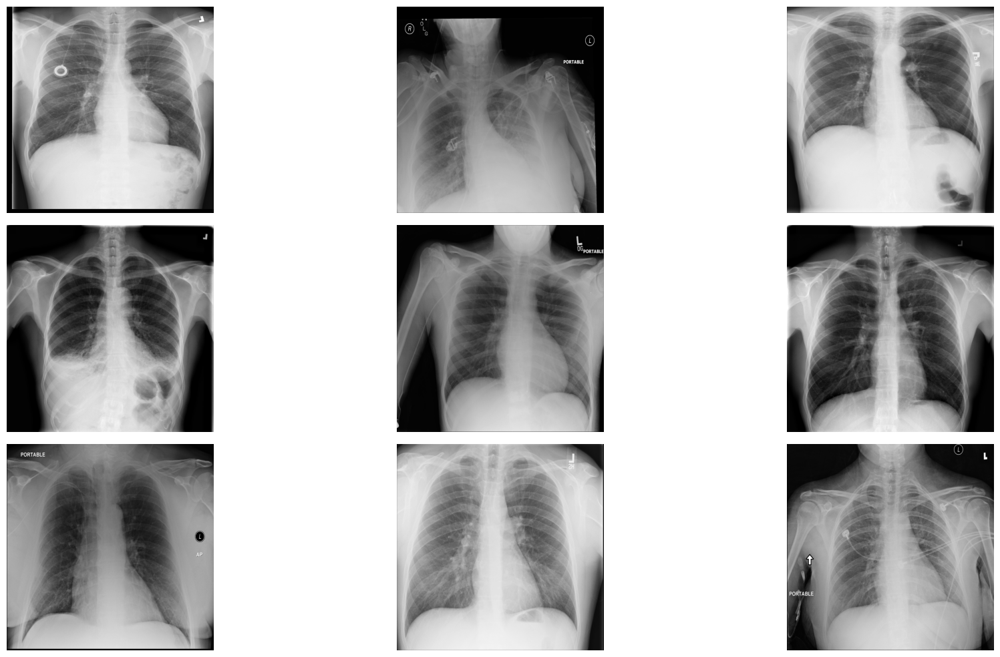

In [ ]:
# Extract numpy values from Image column in data frame
images = train_df['Image'].values

# Extract 9 random images from it
random_images = [np.random.choice(images) for i in range(9)]

# Location of the image dir
img_dir = 'nih/images_small/'

print('Display Random Images')

# Adjust the size of your images
plt.figure(figsize=(20,10))

# Iterate and plot random images
for i in range(9):
    plt.subplot(3, 3, i + 1)
    img = plt.imread(os.path.join(img_dir, random_images[i]))
    plt.imshow(img, cmap='gray')
    plt.axis('off')

# Adjust subplot parameters to give specified padding
plt.tight_layout()

Image 0:
The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 0.9804 and the minimum is 0.0000
The mean value of the pixels is 0.4796 and the standard deviation is 0.2757


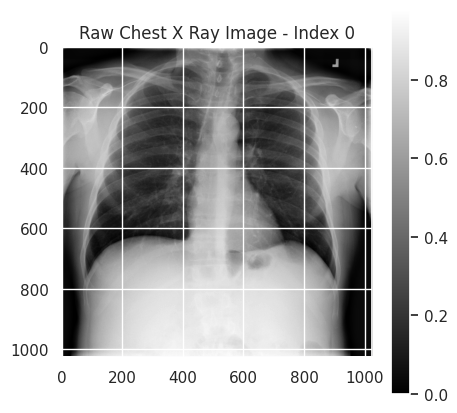

Image 1:
The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 1.0000 and the minimum is 0.0000
The mean value of the pixels is 0.4669 and the standard deviation is 0.2492


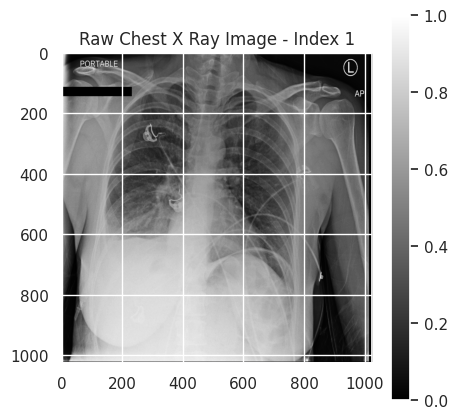

Image 2:
The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 0.9176 and the minimum is 0.0314
The mean value of the pixels is 0.6426 and the standard deviation is 0.1825


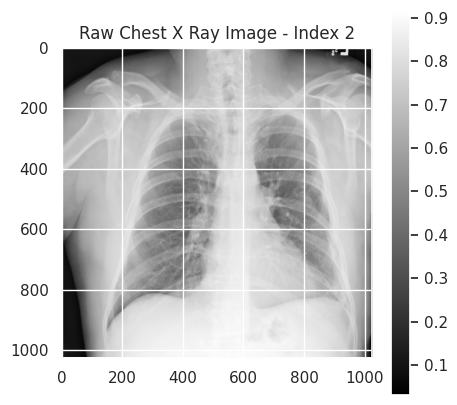

Image 3:
The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 1.0000 and the minimum is 0.0000
The mean value of the pixels is 0.4376 and the standard deviation is 0.2284


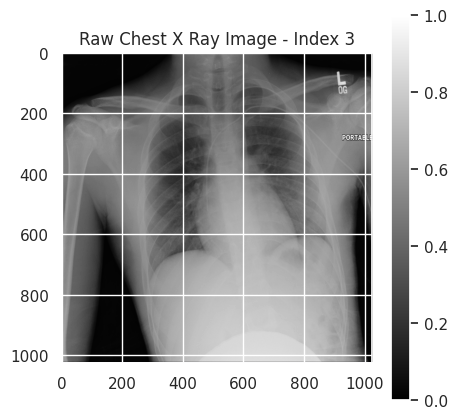

Image 4:
The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 1.0000 and the minimum is 0.0000
The mean value of the pixels is 0.6345 and the standard deviation is 0.2029


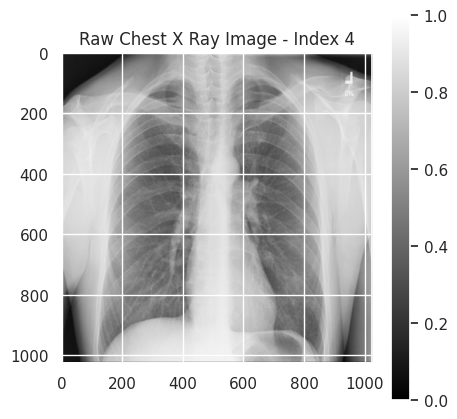

Image 5:
The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 0.9176 and the minimum is 0.0000
The mean value of the pixels is 0.5800 and the standard deviation is 0.2294


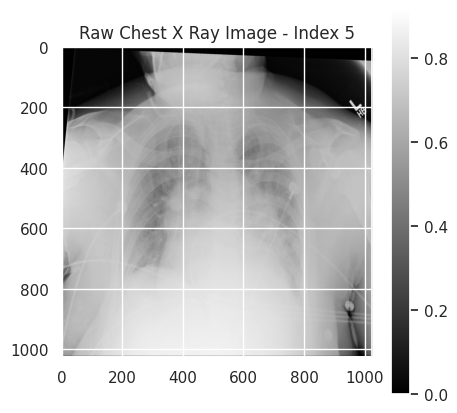

Image 6:
The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 1.0000 and the minimum is 0.0000
The mean value of the pixels is 0.4191 and the standard deviation is 0.2789


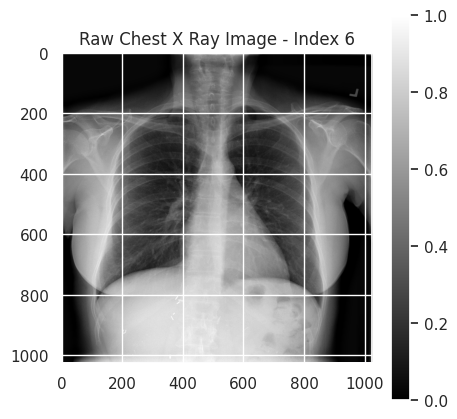

Image 7:
The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 0.8941 and the minimum is 0.0000
The mean value of the pixels is 0.5049 and the standard deviation is 0.2060


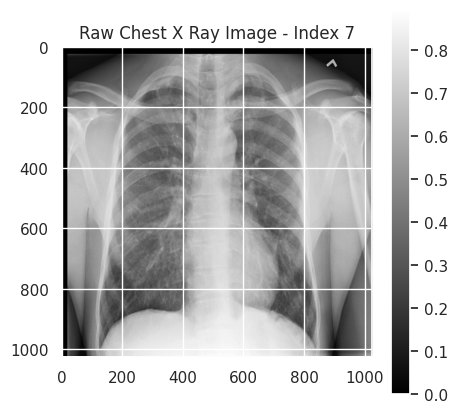

Image 8:
The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 0.6235 and the minimum is 0.0000
The mean value of the pixels is 0.4362 and the standard deviation is 0.1224


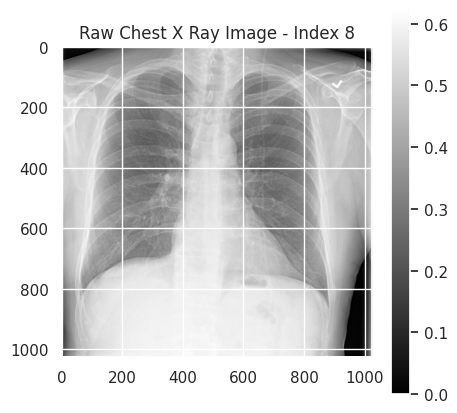

In [ ]:
for i in range(9):
    sample_img = train_df.Image[i]  # 0'dan 8'e kadar indeksler
    raw_image = plt.imread(os.path.join(img_dir, sample_img))
    plt.figure(figsize=(5, 5))
    plt.imshow(raw_image, cmap='gray')
    plt.colorbar()
    plt.title(f'Raw Chest X Ray Image - Index {i}')
    print(f"Image {i}:")
    print(f"The dimensions of the image are {raw_image.shape[0]} pixels width and {raw_image.shape[1]} pixels height, one single color channel")
    print(f"The maximum pixel value is {raw_image.max():.4f} and the minimum is {raw_image.min():.4f}")
    print(f"The mean value of the pixels is {raw_image.mean():.4f} and the standard deviation is {raw_image.std():.4f}")
    plt.show()

In [ ]:
pip install numpy

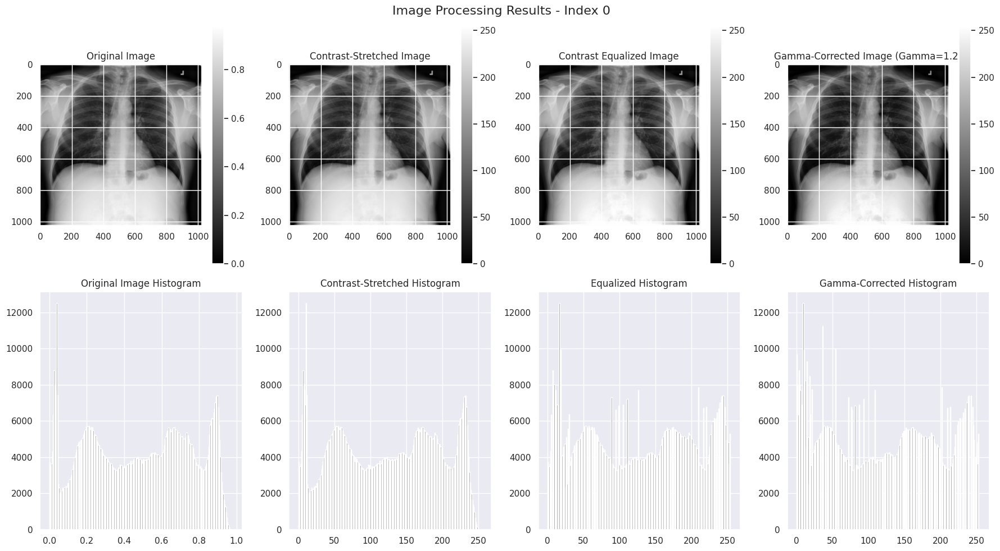

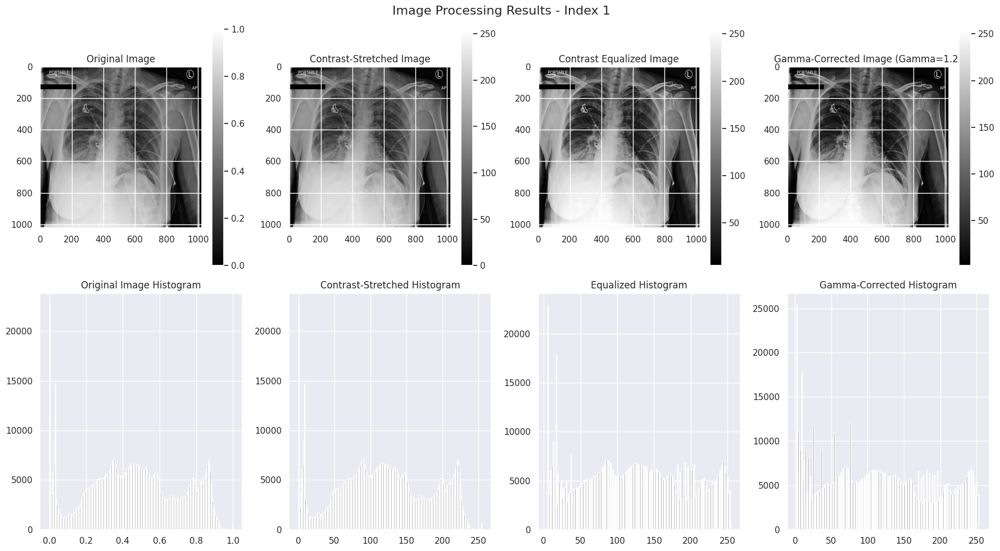

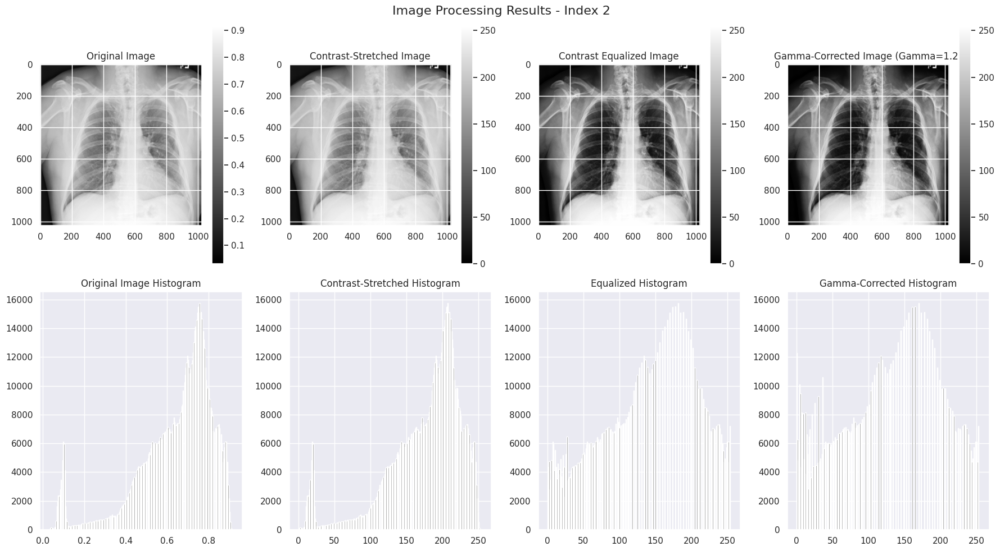

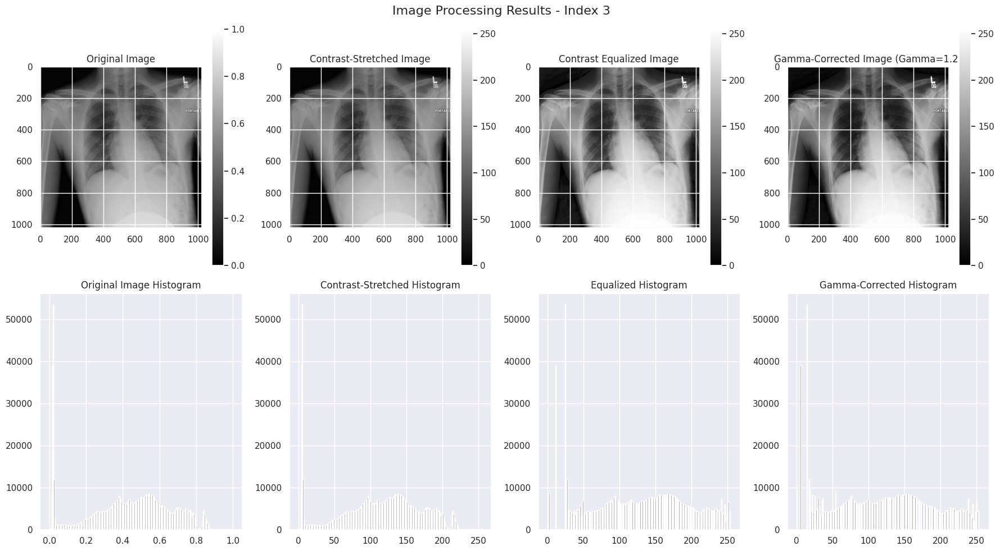

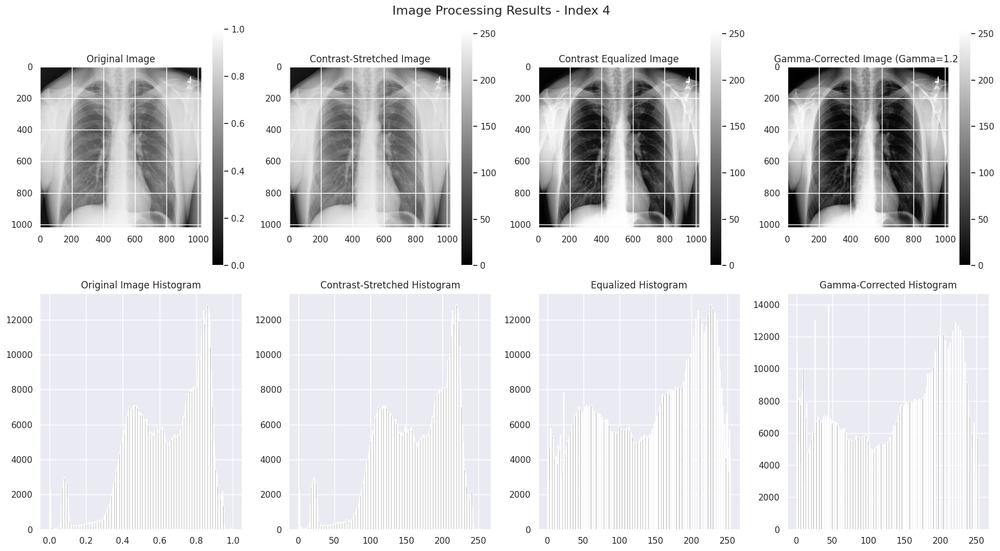

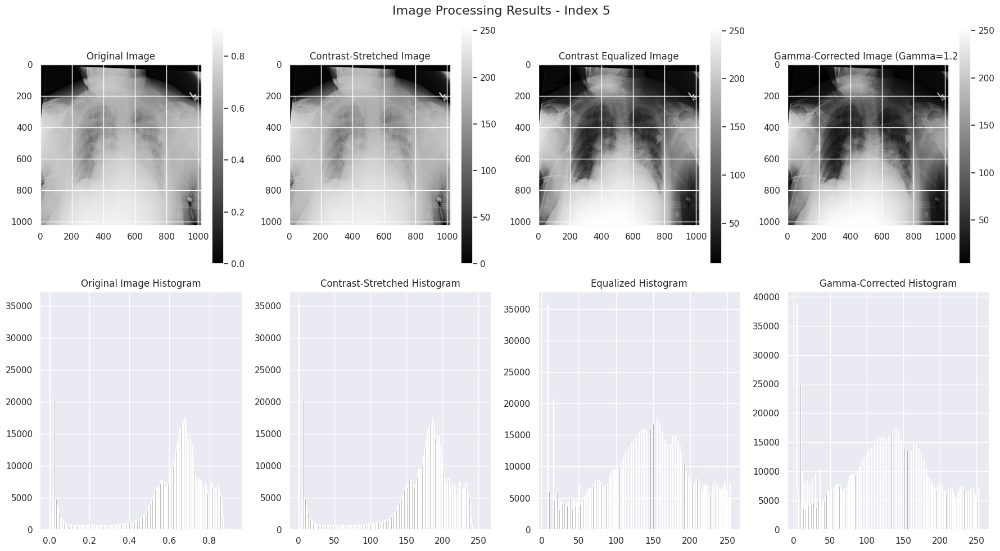

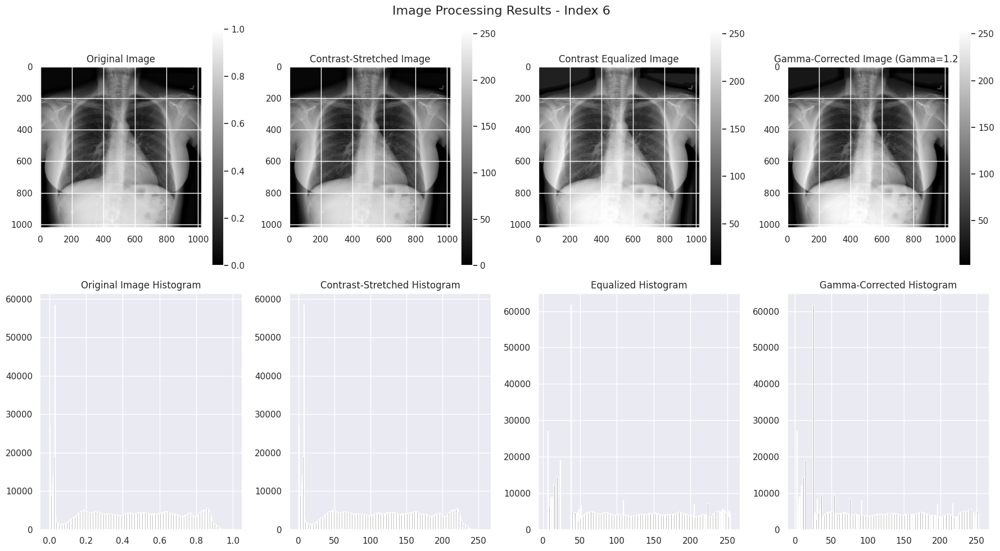

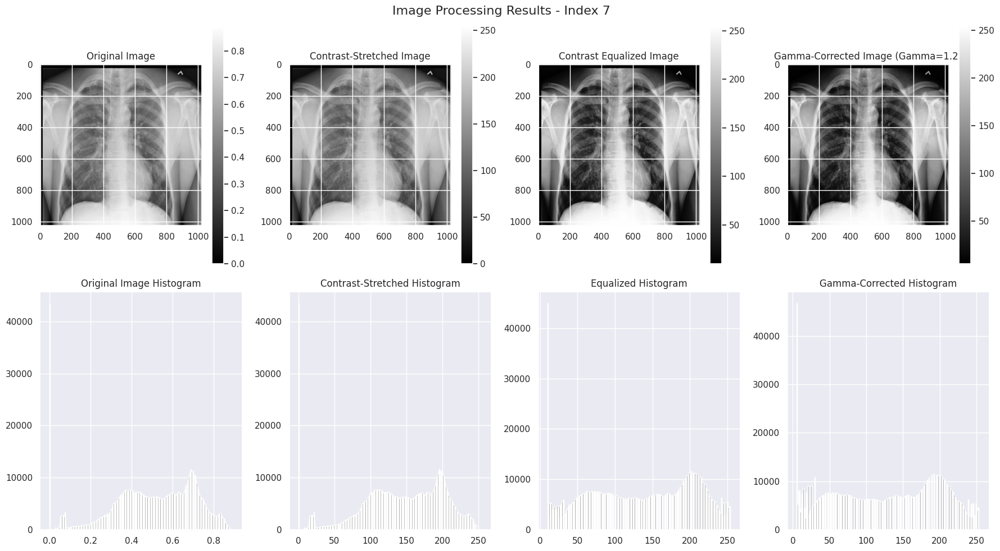

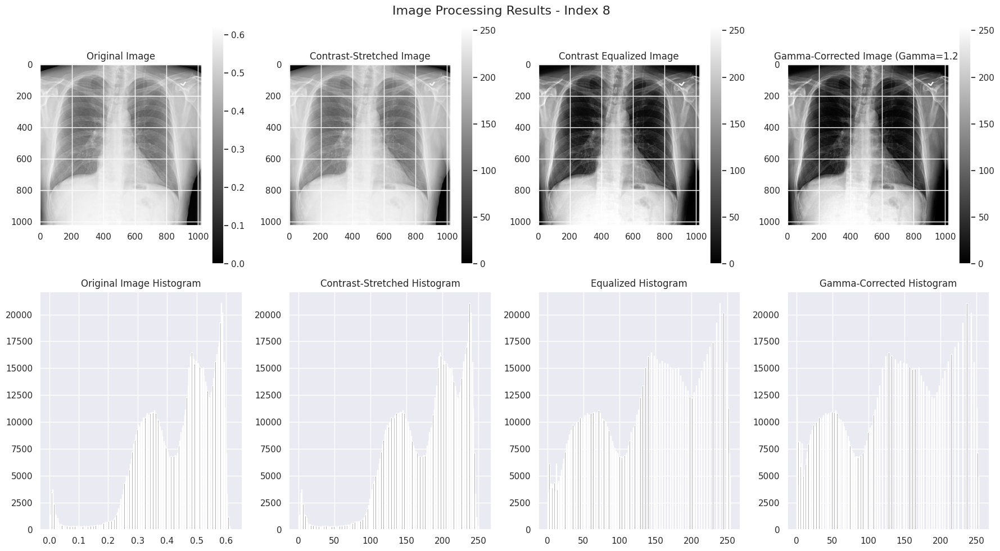

In [ ]:
from skimage import exposure


# Görüntüler için döngü
for i in range(9):
    sample_img = train_df.Image[i]  # 0'dan 8'e kadar indeksler
    raw_image = plt.imread(os.path.join(img_dir, sample_img))

    # Adım 1: Contrast stretching
    min_val, max_val = raw_image.min(), raw_image.max()
    contrast_stretched = (raw_image - min_val) / (max_val - min_val)  # Normalize to [0, 1]
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # Scale to [0, 255] for visualization

    # Adım 2: Histogram equalization
    equalized_image = exposure.equalize_hist(contrast_stretched)  # Returns values in [0, 1]
    equalized_image = (equalized_image * 255).astype(np.uint8)    # Scale to [0, 255]

    # Adım 3: Gamma correction
    gamma = 1.2  # Adjust gamma value as needed
    gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
    gamma_corrected = gamma_corrected.astype(np.uint8)

    # Plot results
    plt.figure(figsize=(18, 10))

    # Orijinal görüntü ve histogram
    plt.subplot(2, 4, 1)
    plt.imshow(raw_image, cmap='gray')
    plt.title('Original Image')
    plt.colorbar()
    plt.subplot(2, 4, 5)
    plt.hist(raw_image.ravel(), bins=256, color='gray')
    plt.title("Original Image Histogram")

    # Contrast-stretched görüntü ve histogram
    plt.subplot(2, 4, 2)
    plt.imshow(contrast_stretched, cmap='gray')
    plt.title('Contrast-Stretched Image')
    plt.colorbar()
    plt.subplot(2, 4, 6)
    plt.hist(contrast_stretched.ravel(), bins=256, color='gray')
    plt.title("Contrast-Stretched Histogram")

    # Equalized görüntü ve histogram
    plt.subplot(2, 4, 3)
    plt.imshow(equalized_image, cmap='gray')
    plt.title('Contrast Equalized Image')
    plt.colorbar()
    plt.subplot(2, 4, 7)
    plt.hist(equalized_image.ravel(), bins=256, color='gray')
    plt.title("Equalized Histogram")

    # Gamma-corrected görüntü ve histogram
    plt.subplot(2, 4, 4)
    plt.imshow(gamma_corrected, cmap='gray')
    plt.title(f'Gamma-Corrected Image (Gamma={gamma})')
    plt.colorbar()
    plt.subplot(2, 4, 8)
    plt.hist(gamma_corrected.ravel(), bins=256, color='gray')
    plt.title("Gamma-Corrected Histogram")

    plt.suptitle(f'Image Processing Results - Index {i}', fontsize=16)
    plt.tight_layout()
    plt.show()

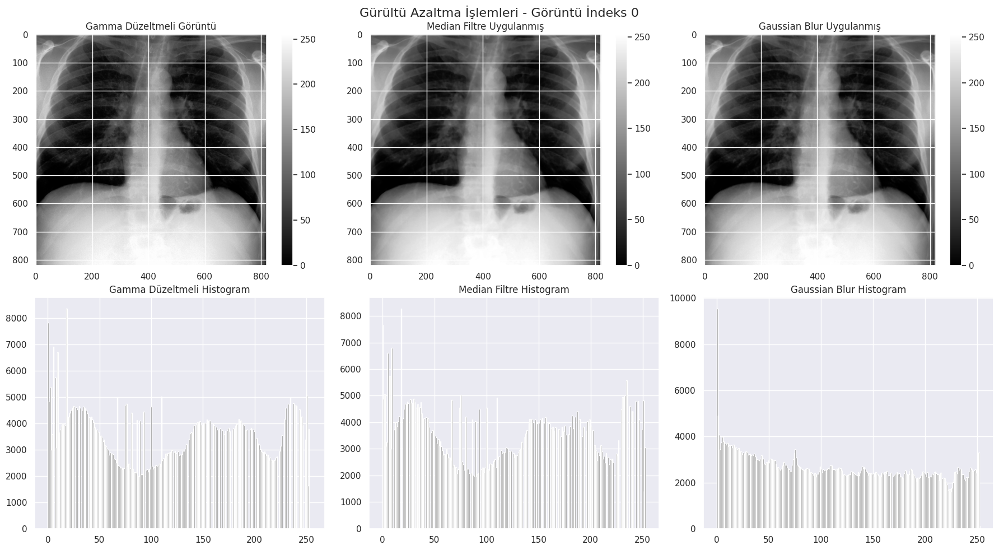

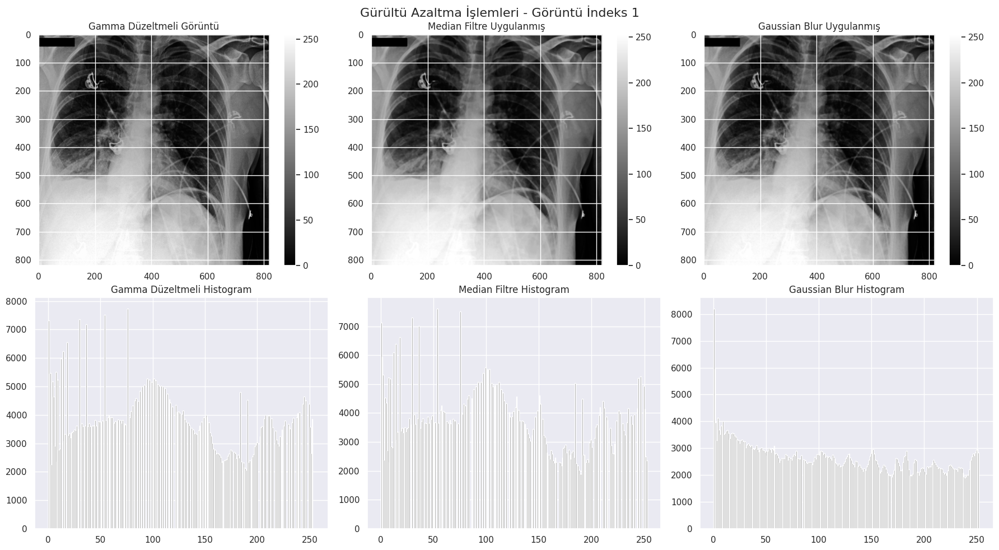

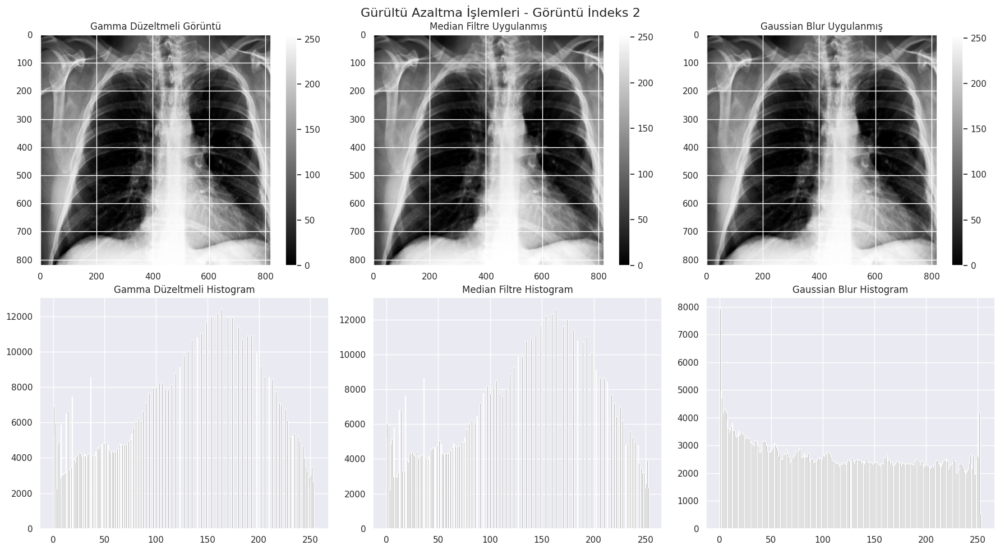

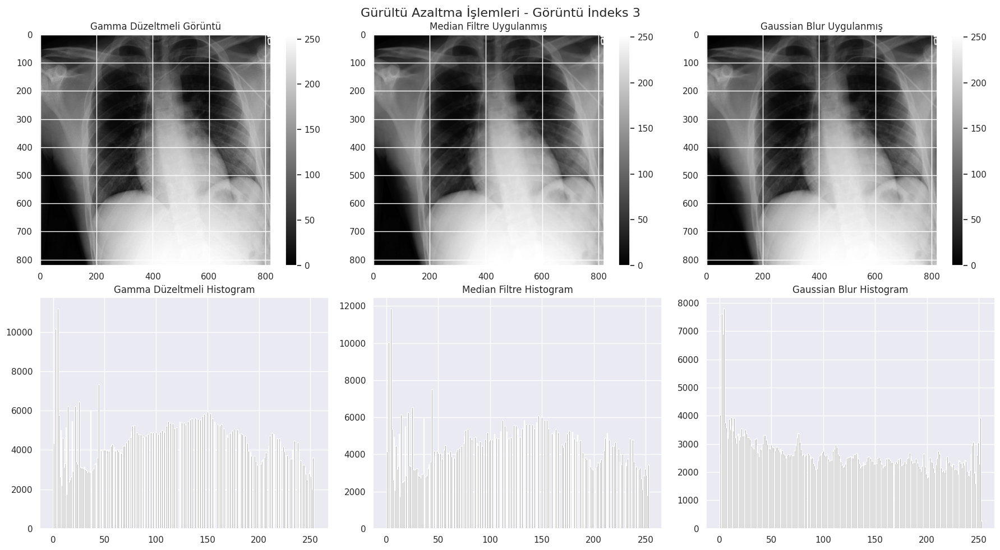

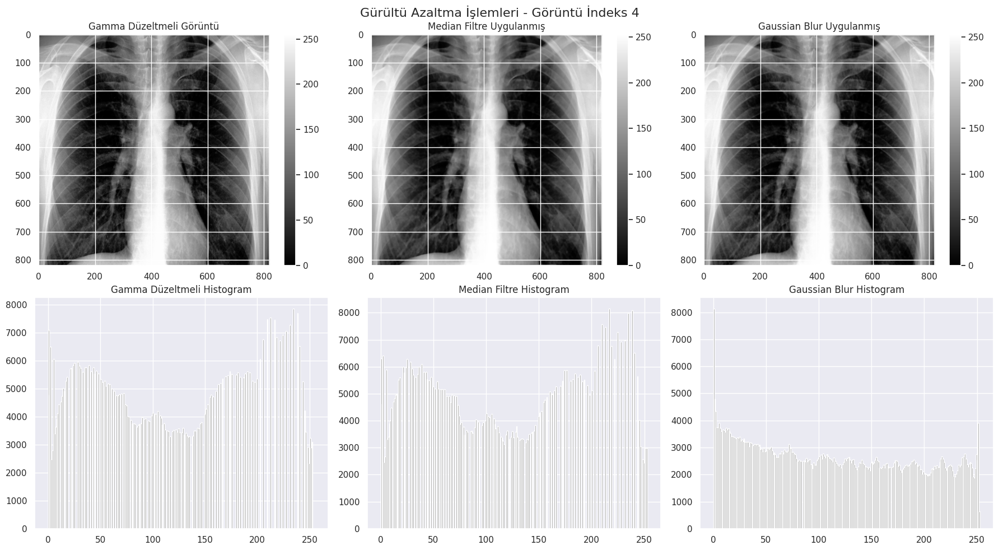

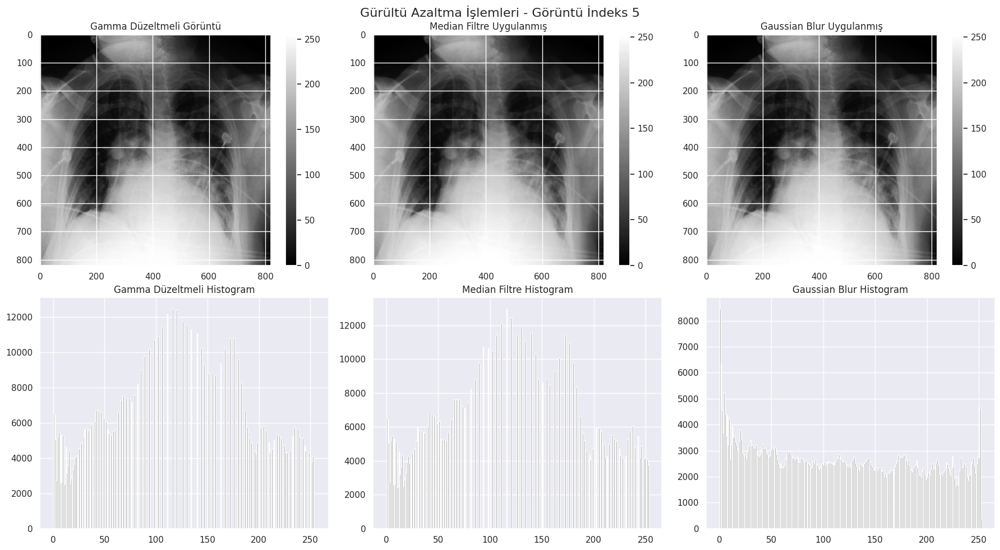

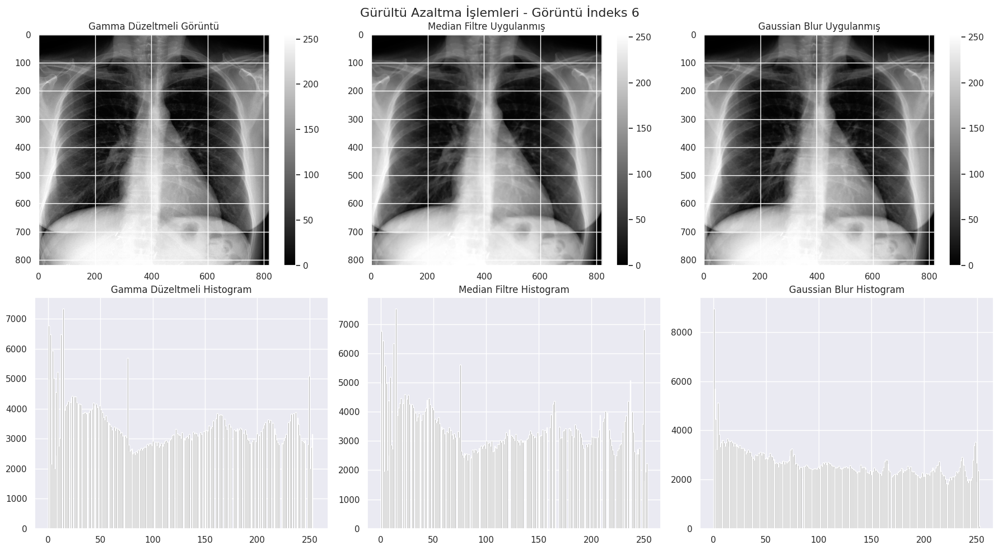

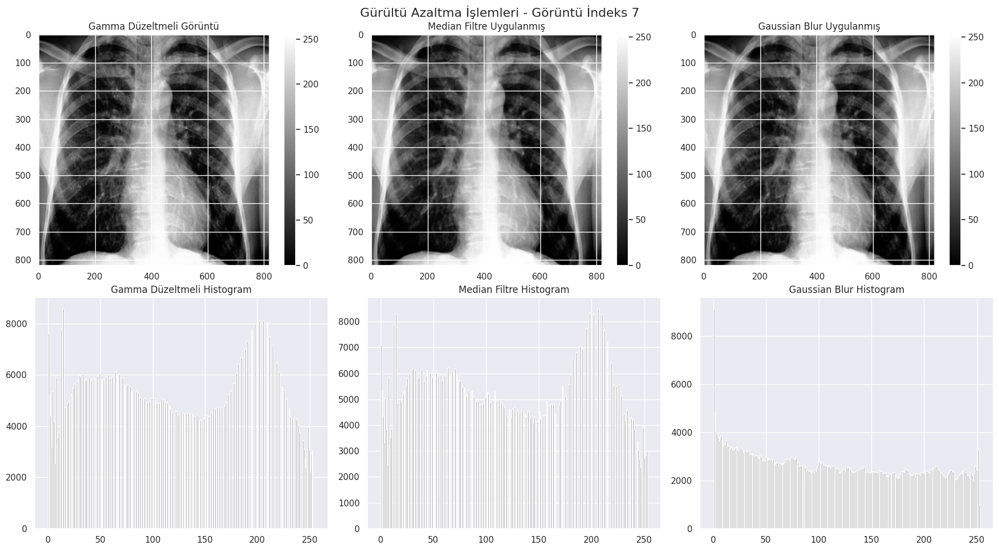

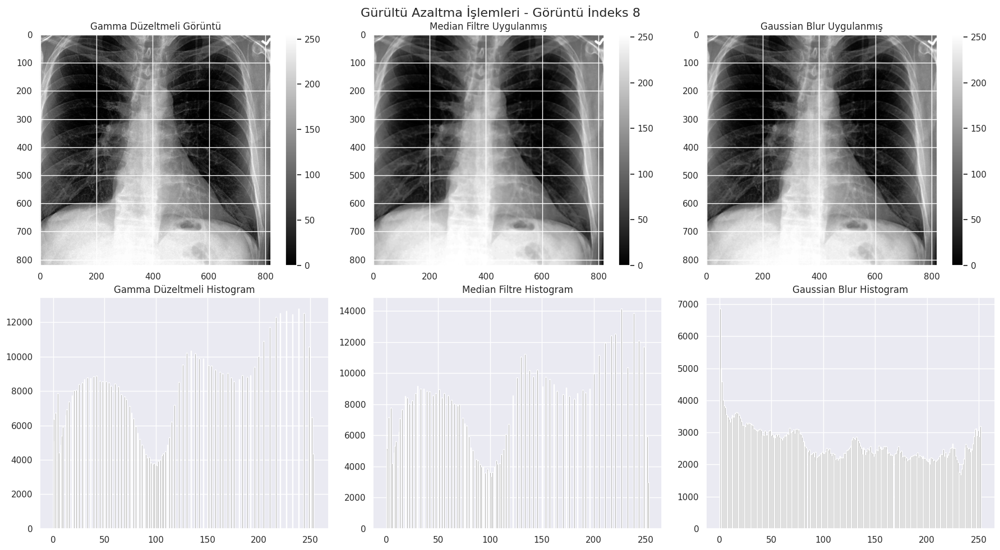

In [ ]:
from skimage import exposure, filters
from skimage.filters import gaussian, median
from skimage.morphology import disk
import matplotlib.pyplot as plt
import numpy as np
import os


for i in range(9):
    sample_img = train_df.Image[i]  # 0'dan 8'e kadar indeksler
    raw_image = plt.imread(os.path.join(img_dir, sample_img))

    # %10 crop: Kenarlardan %10 oranında kırpma
    h, w = raw_image.shape[:2]
    crop_h = int(h * 0.1)
    crop_w = int(w * 0.1)
    cropped_image = raw_image[crop_h: h - crop_h, crop_w: w - crop_w]

    # Adım 1: Kontrast germe (contrast stretching)
    min_val, max_val = cropped_image.min(), cropped_image.max()
    contrast_stretched = (cropped_image - min_val) / (max_val - min_val)
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)

    # Adım 2: Histogram eşitleme
    equalized_image = exposure.equalize_hist(contrast_stretched)
    equalized_image = (equalized_image * 255).astype(np.uint8)

    # Adım 3: Gamma düzeltme
    gamma = 1.2
    gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
    gamma_corrected = gamma_corrected.astype(np.uint8)

    # Adım 4: Gürültü azaltma (Noise Reduction)
    # Seçenek 1: Median filtre (örn: 3 çapında disk yapısı kullanılarak)
    median_filtered = median(gamma_corrected, footprint=disk(3))

    # Seçenek 2: Gaussian Blur (örn: sigma=1)
    gaussian_filtered = gaussian(gamma_corrected, sigma=1)
    # Gaussian işleminin çıktısı [0, 1] aralığında olduğundan tekrar [0, 255]'e ölçekleniyor
    gaussian_filtered = (gaussian_filtered * 255).astype(np.uint8)

    # Sonuçları görselleştirme
    plt.figure(figsize=(18, 10))

    # Orijinal gamma düzeltilmiş görüntü
    plt.subplot(2, 3, 1)
    plt.imshow(gamma_corrected, cmap='gray')
    plt.title('Gamma Düzeltmeli Görüntü')
    plt.colorbar()

    # Median filtre uygulanmış görüntü
    plt.subplot(2, 3, 2)
    plt.imshow(median_filtered, cmap='gray')
    plt.title('Median Filtre Uygulanmış')
    plt.colorbar()

    # Gaussian Blur uygulanmış görüntü
    plt.subplot(2, 3, 3)
    plt.imshow(gaussian_filtered, cmap='gray')
    plt.title('Gaussian Blur Uygulanmış')
    plt.colorbar()

    # Histogramlar
    plt.subplot(2, 3, 4)
    plt.hist(gamma_corrected.ravel(), bins=256, color='gray')
    plt.title('Gamma Düzeltmeli Histogram')

    plt.subplot(2, 3, 5)
    plt.hist(median_filtered.ravel(), bins=256, color='gray')
    plt.title('Median Filtre Histogram')

    plt.subplot(2, 3, 6)
    plt.hist(gaussian_filtered.ravel(), bins=256, color='gray')
    plt.title('Gaussian Blur Histogram')

    plt.suptitle(f'Gürültü Azaltma İşlemleri - Görüntü İndeks {i}', fontsize=16)
    plt.tight_layout()
    plt.show()

In [ ]:
def gaussian_intensity_transform(image, mean, sigma):
    """
    Görüntüyü normalize ettikten sonra, Gaussian fonksiyonu ile yoğunluk dönüşümü uygular.
    Parametreler:
      - image: [0,255] aralığındaki giriş görüntüsü.
      - mean: Dinamik olarak hesaplanmış ortalama (0-1 aralığında)
      - sigma: Dinamik olarak hesaplanmış standart sapma (0-1 aralığında)
    Dönüşüm sonucu [0,1] aralığında elde edilir.
    """
    image_norm = image / 255.0
    transformed = np.exp(-((image_norm - mean) ** 2) / (2 * sigma ** 2))
    return transformed

Görüntü 0: Dinamik Ortalama = 0.504, Dinamik Sigma = 0.249


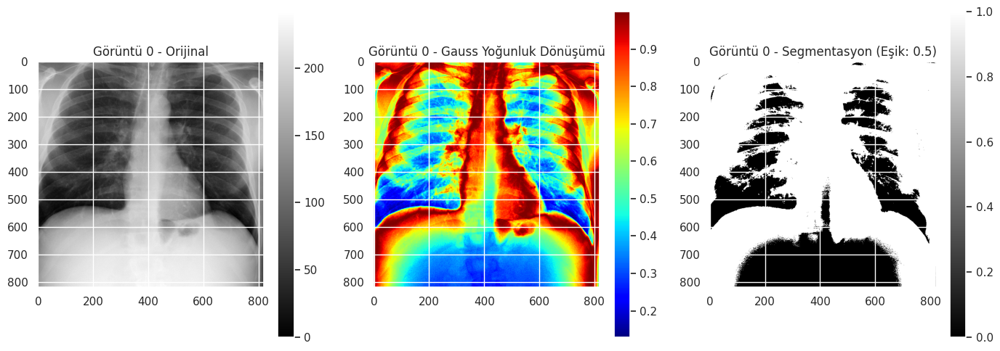

Görüntü 1: Dinamik Ortalama = 0.499, Dinamik Sigma = 0.219


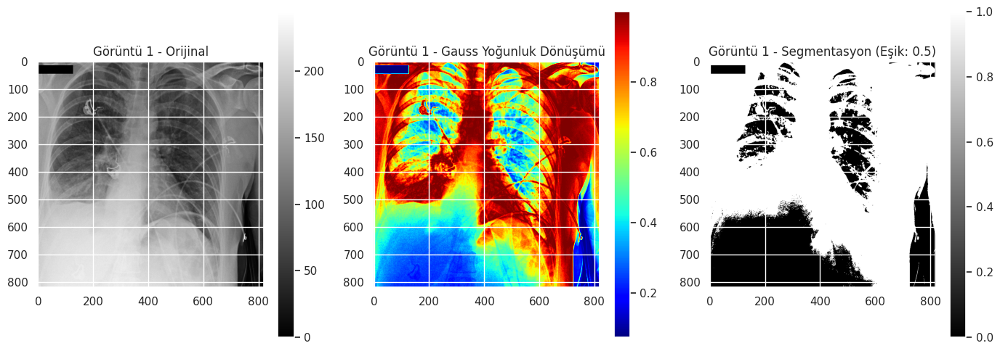

Görüntü 2: Dinamik Ortalama = 0.680, Dinamik Sigma = 0.118


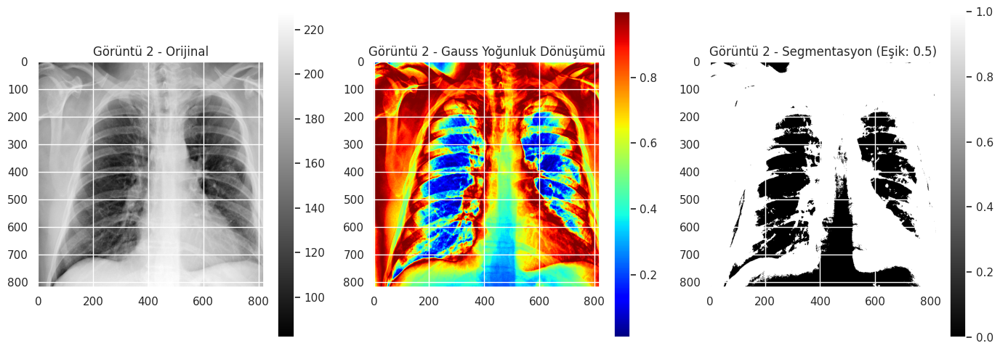

Görüntü 3: Dinamik Ortalama = 0.479, Dinamik Sigma = 0.191


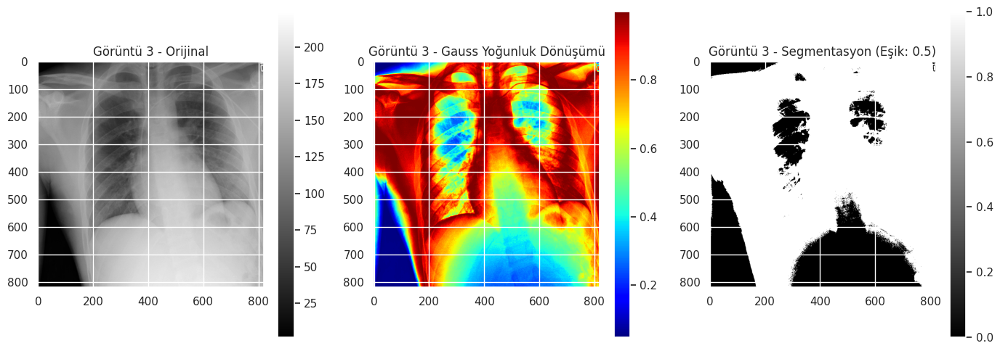

Görüntü 4: Dinamik Ortalama = 0.634, Dinamik Sigma = 0.170


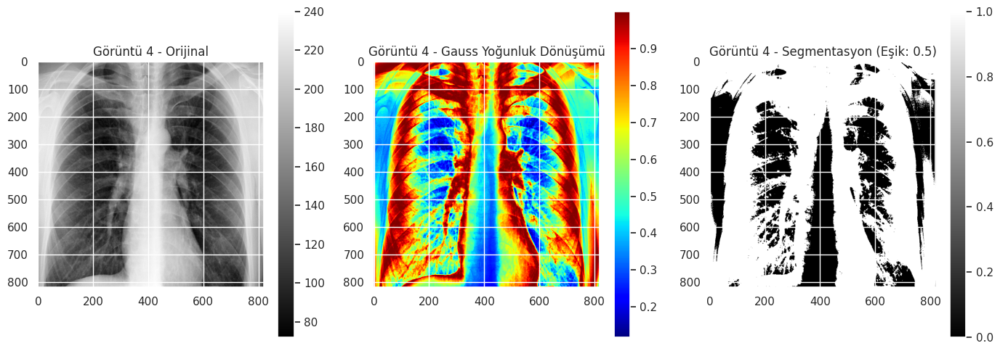

Görüntü 5: Dinamik Ortalama = 0.626, Dinamik Sigma = 0.154


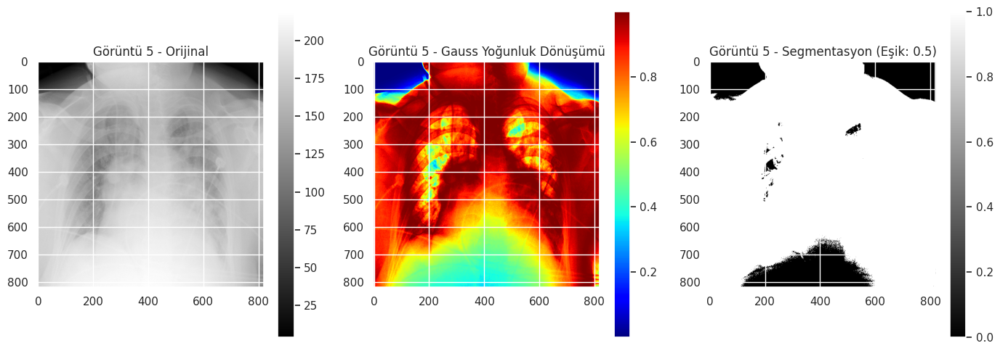

Görüntü 6: Dinamik Ortalama = 0.472, Dinamik Sigma = 0.241


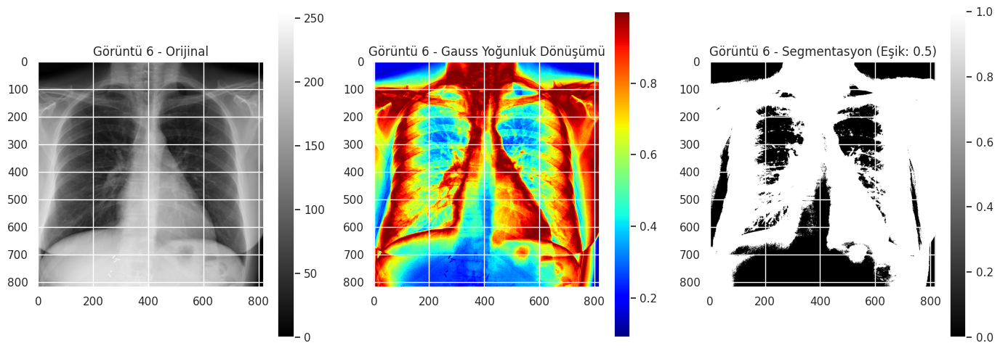

Görüntü 7: Dinamik Ortalama = 0.531, Dinamik Sigma = 0.148


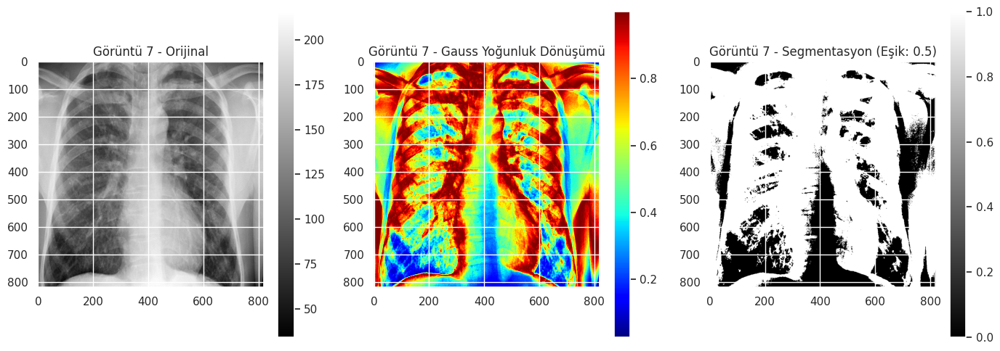

Görüntü 8: Dinamik Ortalama = 0.439, Dinamik Sigma = 0.105


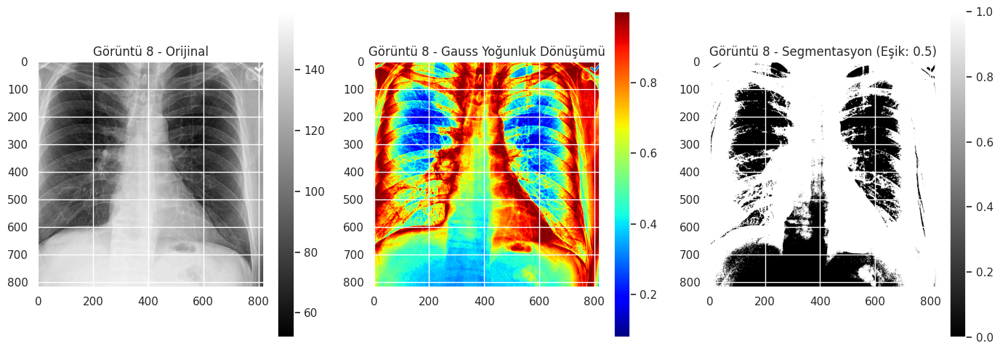

In [ ]:
for i in range(9):
    # Görüntüyü train_df ve img_dir üzerinden alıyoruz
    sample_img = train_df.Image[i]
    raw_image = plt.imread(os.path.join(img_dir, sample_img))

    # Eğer gerekliyse %10 crop işlemi (her kenardan %10 kırpma):
    h, w = raw_image.shape[:2]
    crop_h = int(h * 0.1)
    crop_w = int(w * 0.1)
    cropped_image = raw_image[crop_h : h - crop_h, crop_w : w - crop_w]

    # Görüntü tipi kontrolü: Eğer görüntü [0,1] aralığında float tipinde ise, [0,255]'e ölçeklendiriyoruz.
    if cropped_image.dtype != np.uint8:
        cropped_image = (cropped_image * 255).astype(np.uint8)

    # Dinamik olarak ortalama ve standart sapmayı hesaplayalım.
    # Görüntüyü önce [0,1] aralığına normalize ediyoruz:
    norm_img = cropped_image / 255.0
    dynamic_mean = np.mean(norm_img)
    dynamic_sigma = np.std(norm_img)
    print(f"Görüntü {i}: Dinamik Ortalama = {dynamic_mean:.3f}, Dinamik Sigma = {dynamic_sigma:.3f}")

    # Gaussian yoğunluk dönüşümünü, dinamik ortalama ve sigma kullanarak uyguluyoruz.
    transformed = gaussian_intensity_transform(cropped_image, mean=dynamic_mean, sigma=dynamic_sigma)

    # Tek eşik uygulaması: Örneğin, dönüşüm sonucu > 0.5 olan değerleri 1, diğerlerini 0 yapıyoruz.
    binary_single = (transformed > 0.5).astype(np.uint8)

    # Sonuçların görselleştirilmesi:
    plt.figure(figsize=(14, 5))

    # Orijinal (crop edilmiş) görüntü
    plt.subplot(1, 3, 1)
    plt.imshow(cropped_image, cmap='gray')
    plt.title(f"Görüntü {i} - Orijinal")
    plt.colorbar()

    # Gaussian yoğunluk dönüşümü uygulanmış görüntü
    plt.subplot(1, 3, 2)
    plt.imshow(transformed, cmap='jet')
    plt.title(f"Görüntü {i} - Gauss Yoğunluk Dönüşümü")
    plt.colorbar()

    # Tek eşik segmentasyonu sonucu
    plt.subplot(1, 3, 3)
    plt.imshow(binary_single, cmap='gray')
    plt.title(f"Görüntü {i} - Segmentasyon (Eşik: 0.5)")
    plt.colorbar()

    plt.tight_layout()
    plt.show()

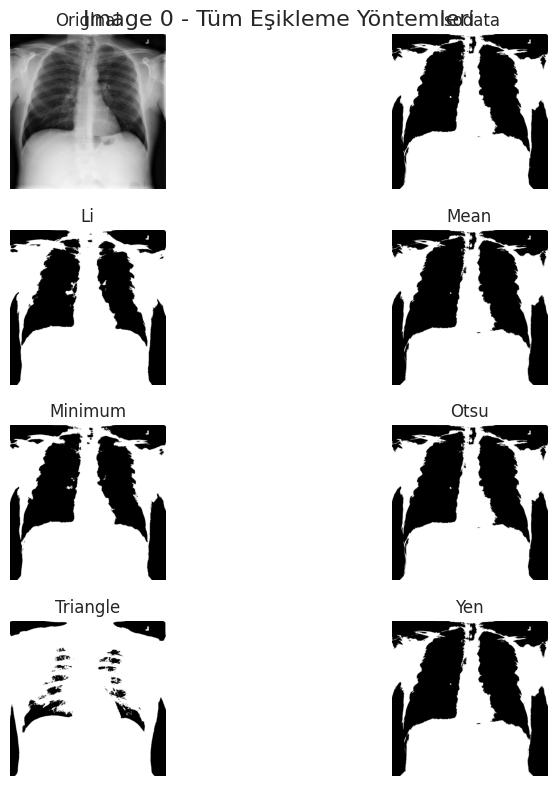

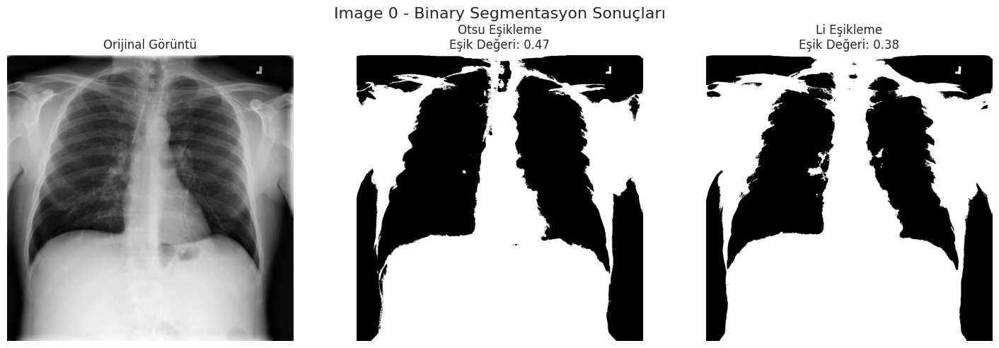

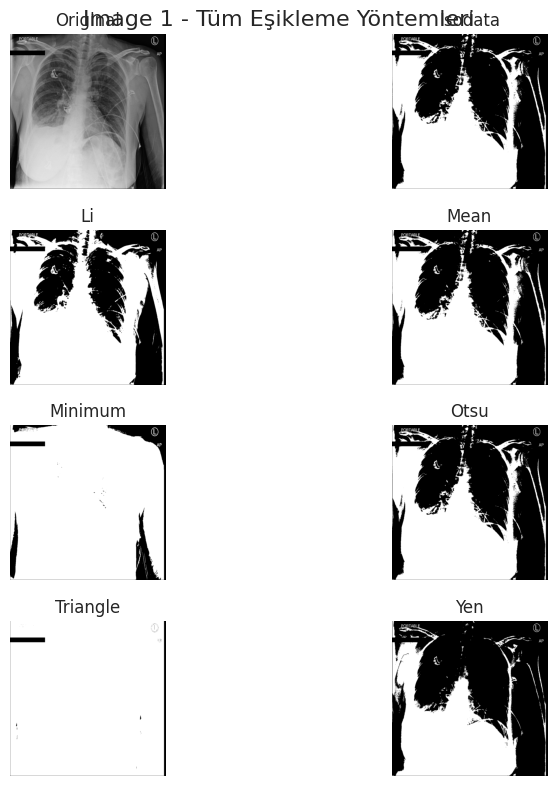

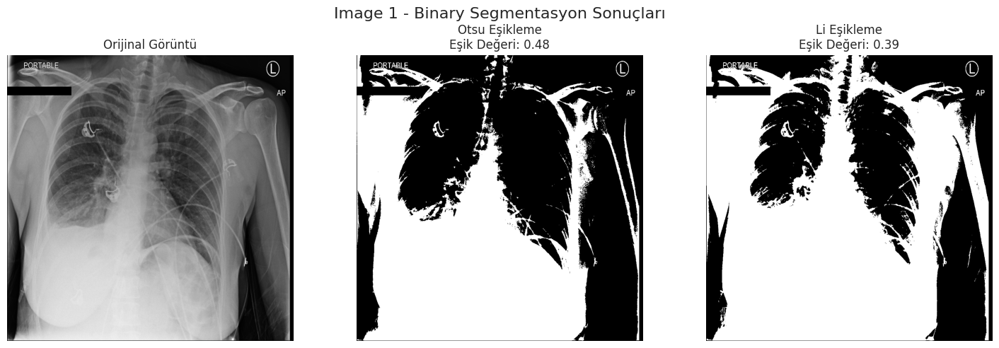

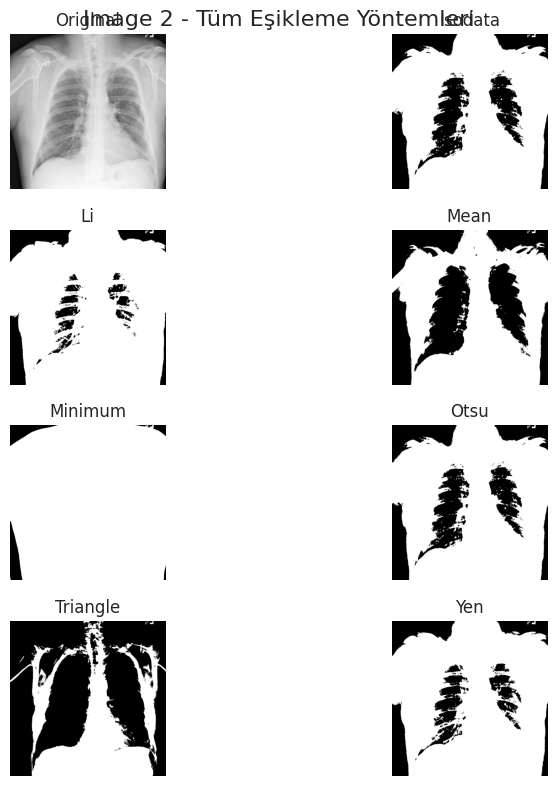

...

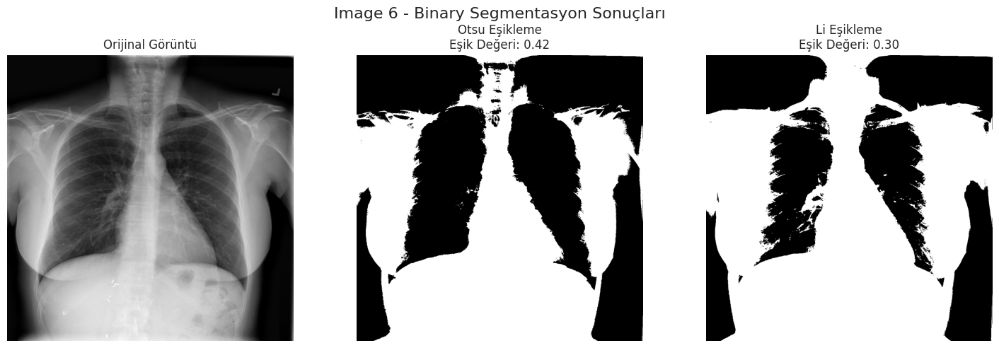

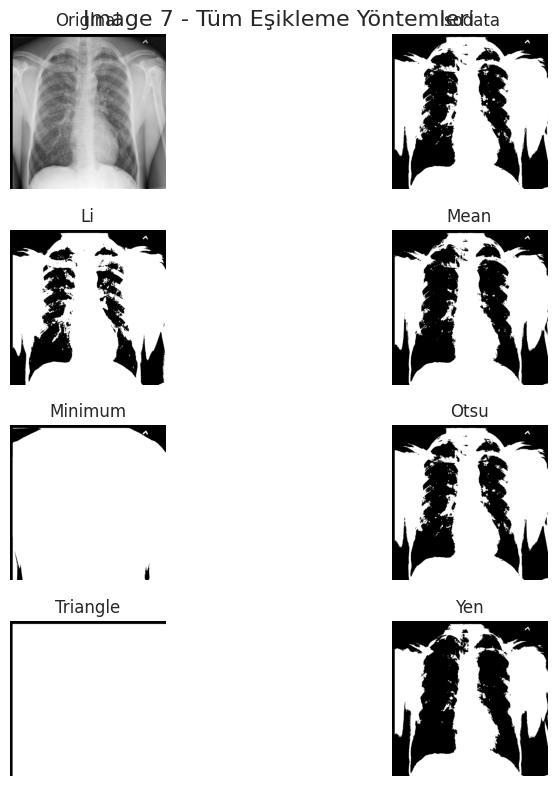

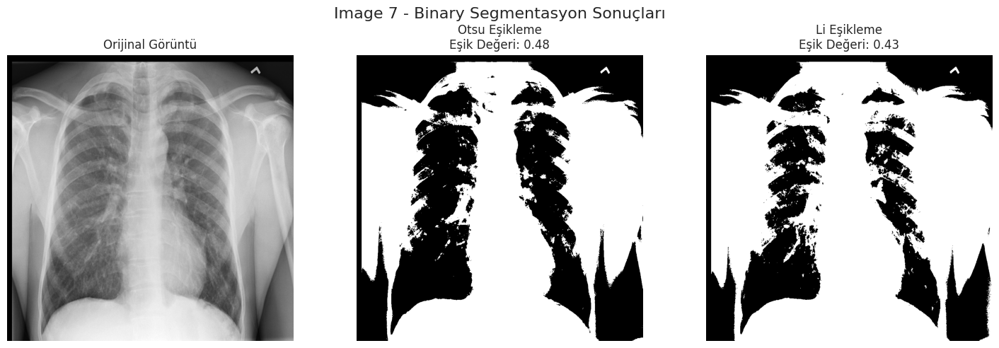

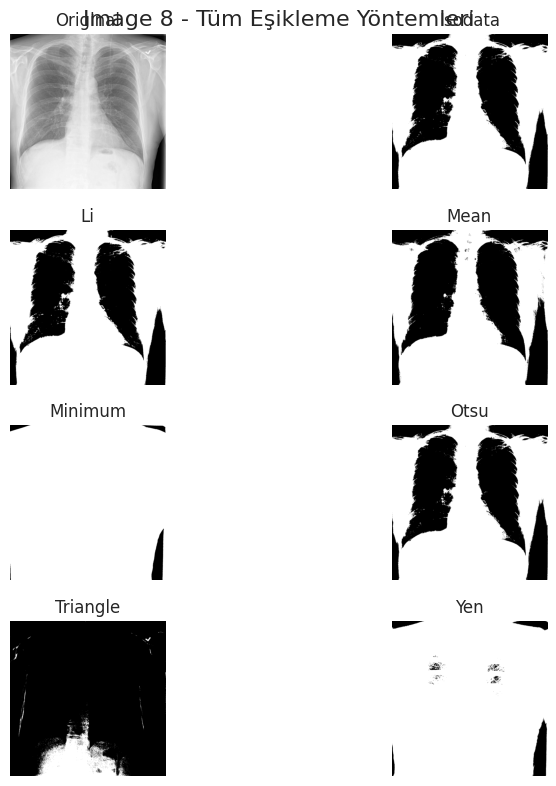

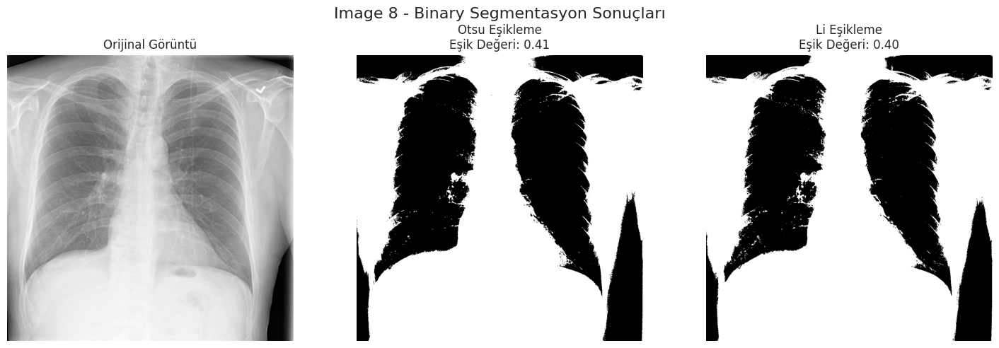

In [ ]:
from skimage import color
from skimage.filters import try_all_threshold, threshold_otsu, threshold_li



for i in range(9):
    # Görüntüyü yükleyelim
    sample_img = train_df.Image[i]
    image = plt.imread(os.path.join(img_dir, sample_img))

    if image.ndim == 3:
        image = color.rgb2gray(image)

    # ---------------------------
    # 1. try_all_threshold kullanarak
    #    Farklı thresholding yöntemlerinin sonuçlarını tek seferde görselleştiriyoruz.
    # ---------------------------
    fig, ax = try_all_threshold(image, verbose=False, figsize=(10, 8))
    plt.suptitle(f"Image {i} - Tüm Eşikleme Yöntemleri", fontsize=16)
    plt.show()

    # ---------------------------
    # 2. Otsu ve Li eşikleme yöntemlerini ayrı ayrı uygulayalım.
    # ---------------------------
    thresh_otsu = threshold_otsu(image)
    thresh_li = threshold_li(image)

    # Binary görüntüler elde ediyoruz:
    binary_otsu = image > thresh_otsu
    binary_li = image > thresh_li

    # Sonuçların görselleştirilmesi:
    plt.figure(figsize=(15, 5))

    # Orijinal görüntü
    plt.subplot(1, 3, 1)
    plt.imshow(image, cmap='gray')
    plt.title("Orijinal Görüntü")
    plt.axis('off')

    # Otsu yöntemi ile segmentasyon sonucu
    plt.subplot(1, 3, 2)
    plt.imshow(binary_otsu, cmap='gray')
    plt.title(f"Otsu Eşikleme\nEşik Değeri: {thresh_otsu:.2f}")
    plt.axis('off')

    # Li yöntemi ile segmentasyon sonucu
    plt.subplot(1, 3, 3)
    plt.imshow(binary_li, cmap='gray')
    plt.title(f"Li Eşikleme\nEşik Değeri: {thresh_li:.2f}")
    plt.axis('off')

    plt.suptitle(f"Image {i} - Binary Segmentasyon Sonuçları", fontsize=16)
    plt.tight_layout()
    plt.show()

Otsu Yönteminin Avantajları:
Otsu yöntemi, görüntünün histogramını analiz ederek, nesne ve arka plan arasındaki yoğunluk farkını en iyi şekilde ayıracak eşik değerini otomatik olarak belirler. Bu sayede, özellikle histogramda iki belirgin yoğunluk grubu olduğunda, segmentasyon sonuçları oldukça başarılı olur.

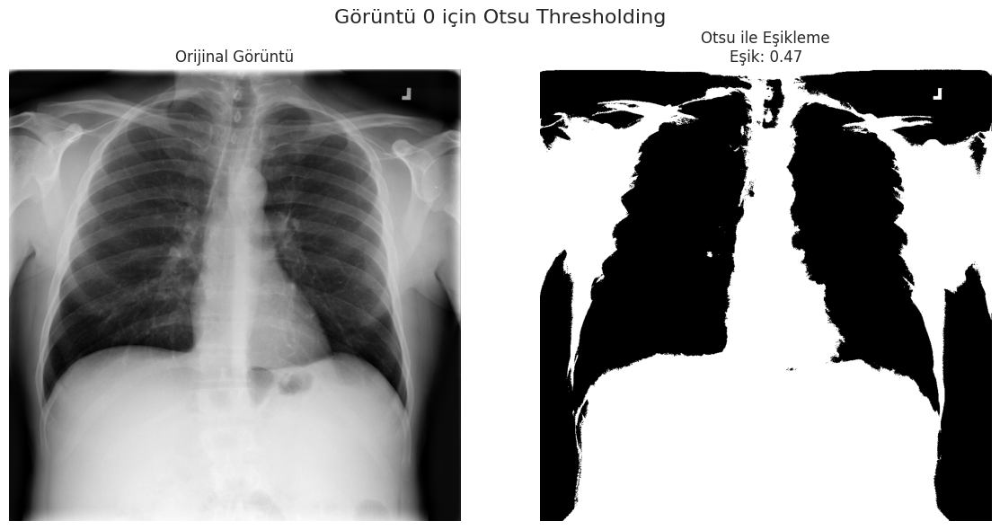

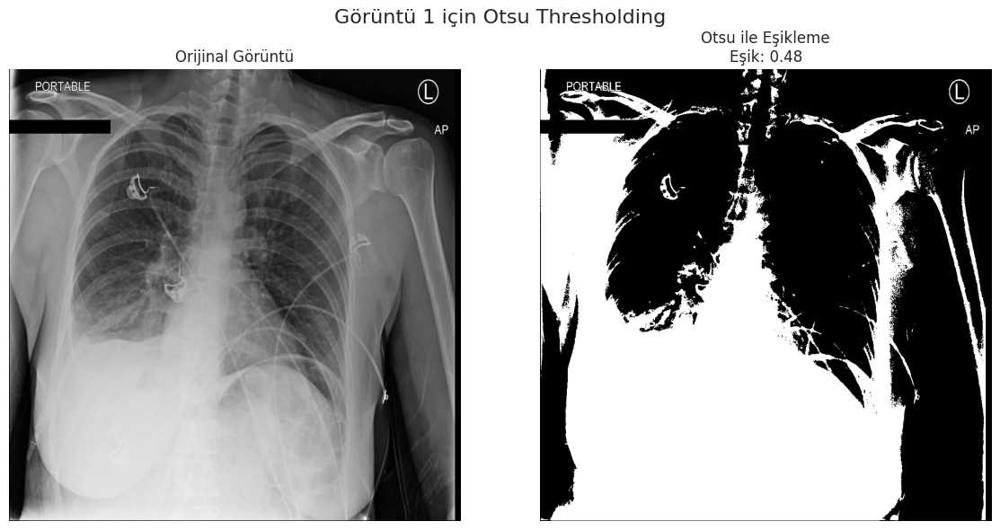

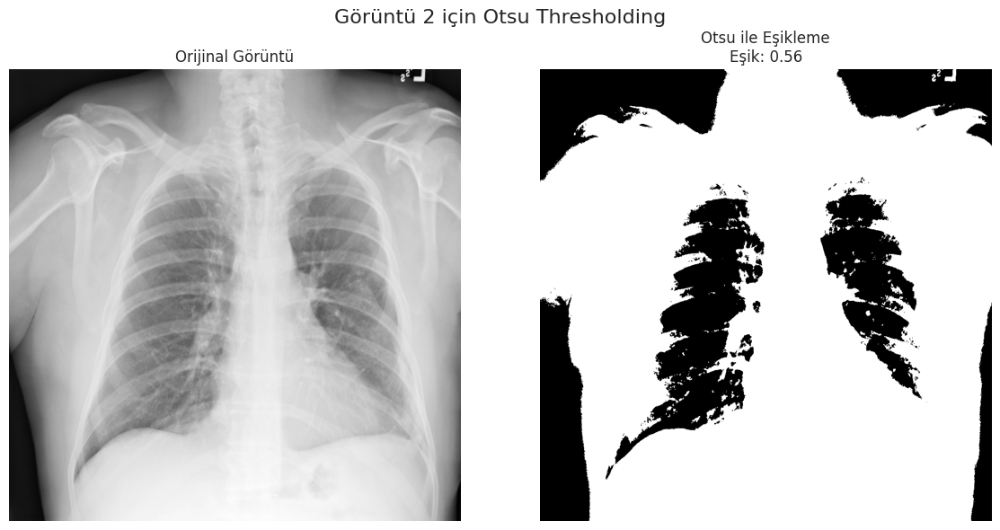

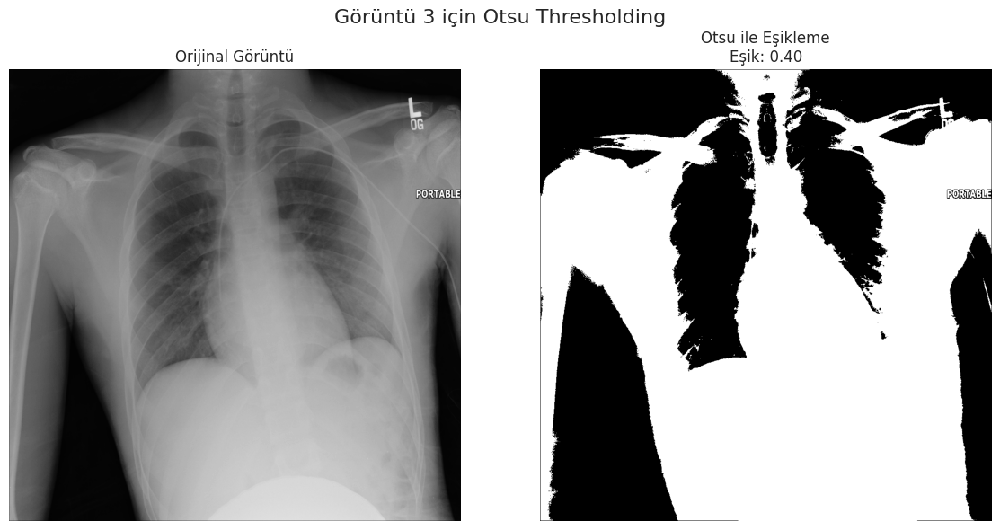

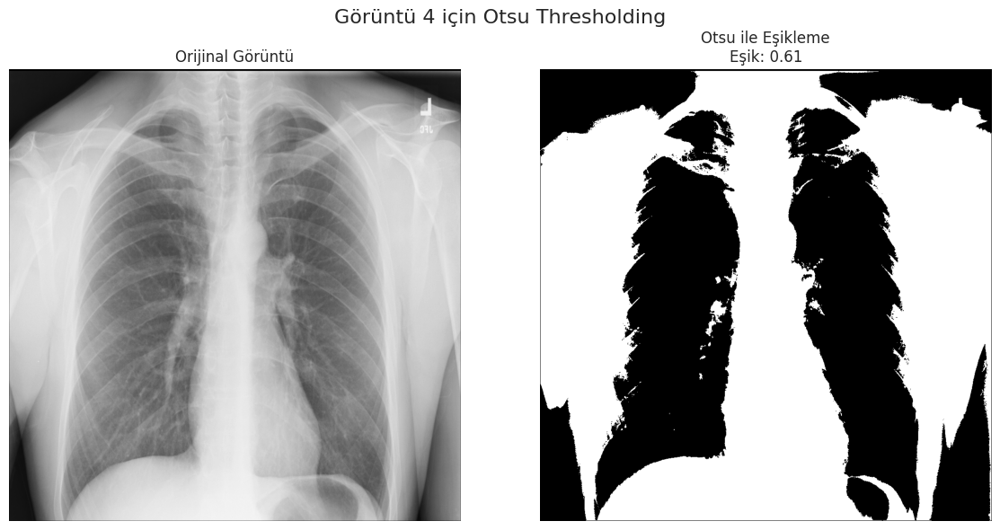

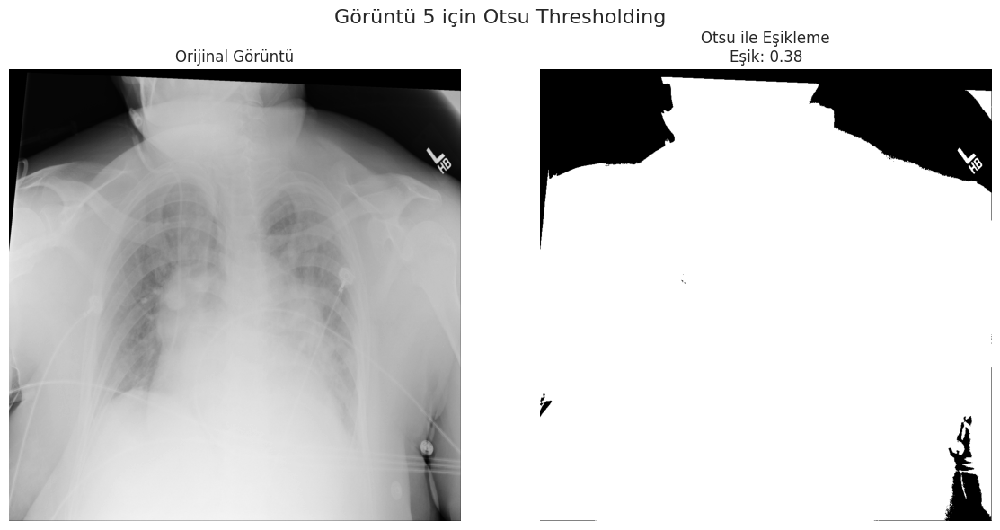

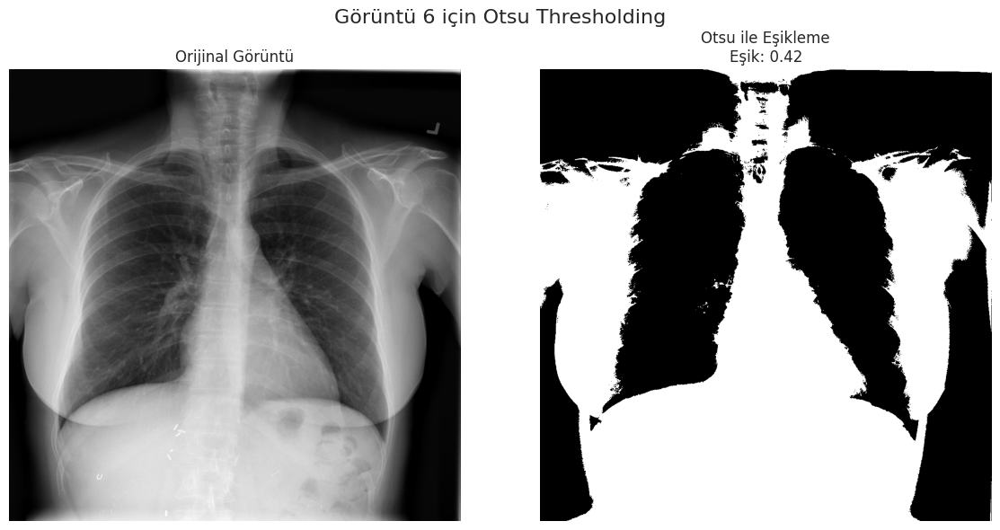

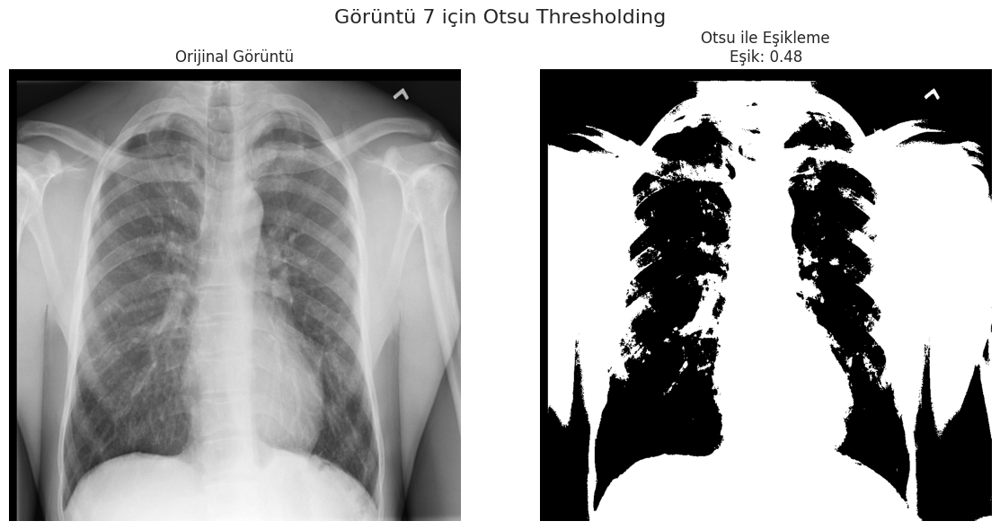

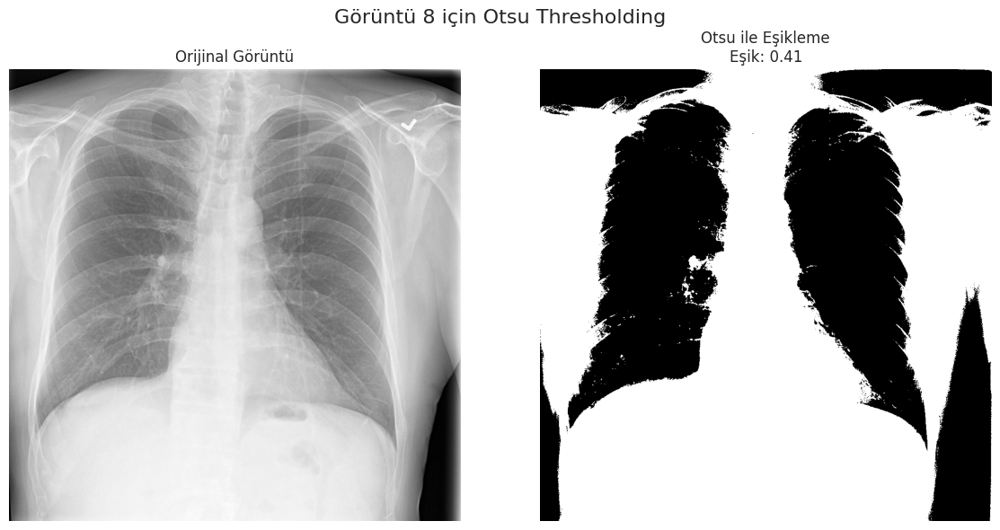

In [ ]:
for i in range(9):
    # Görüntüyü yükle
    sample_img = train_df.Image[i]
    image = plt.imread(os.path.join(img_dir, sample_img))

    # Eğer görüntü renkliyse, gri tonlamaya çeviriyoruz
    if image.ndim == 3:
        image = color.rgb2gray(image)

    # Otsu eşikleme yöntemiyle eşik değeri belirleniyor
    otsu_thresh = threshold_otsu(image)
    binary_otsu = image > otsu_thresh

    # Sonuçların görselleştirilmesi
    plt.figure(figsize=(12, 6))

    # Orijinal görüntü
    plt.subplot(1, 2, 1)
    plt.imshow(image, cmap='gray')
    plt.title("Orijinal Görüntü")
    plt.axis('off')

    # Otsu eşikleme sonucu
    plt.subplot(1, 2, 2)
    plt.imshow(binary_otsu, cmap='gray')
    plt.title(f"Otsu ile Eşikleme\nEşik: {otsu_thresh:.2f}")
    plt.axis('off')

    plt.suptitle(f"Görüntü {i} için Otsu Thresholding", fontsize=16)
    plt.tight_layout()
    plt.show()

POST- PROCESSSING

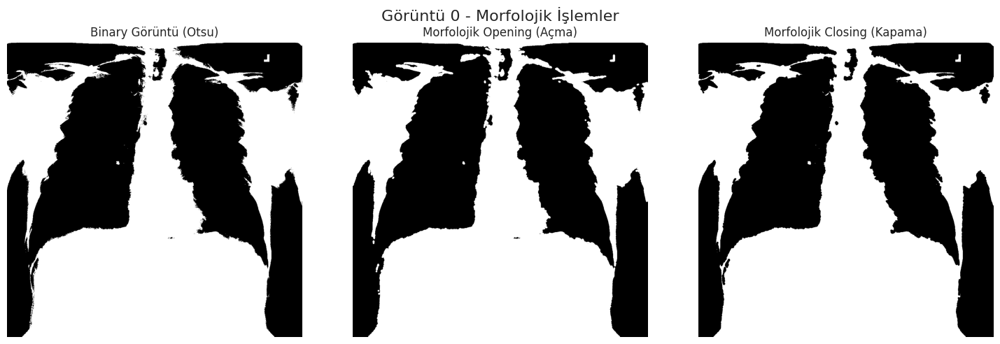

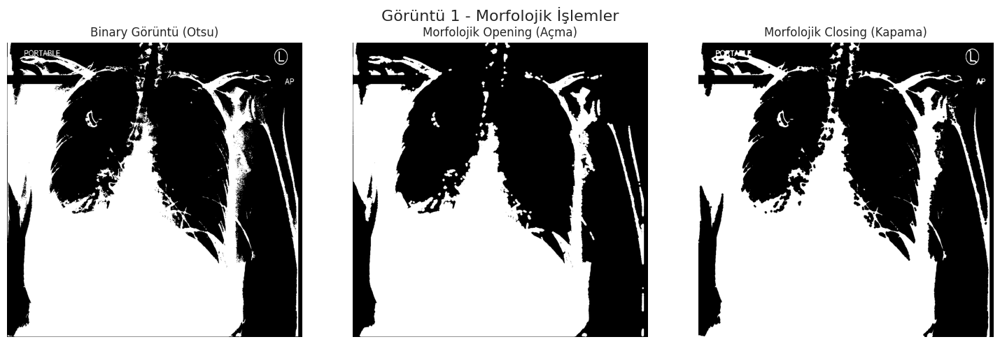

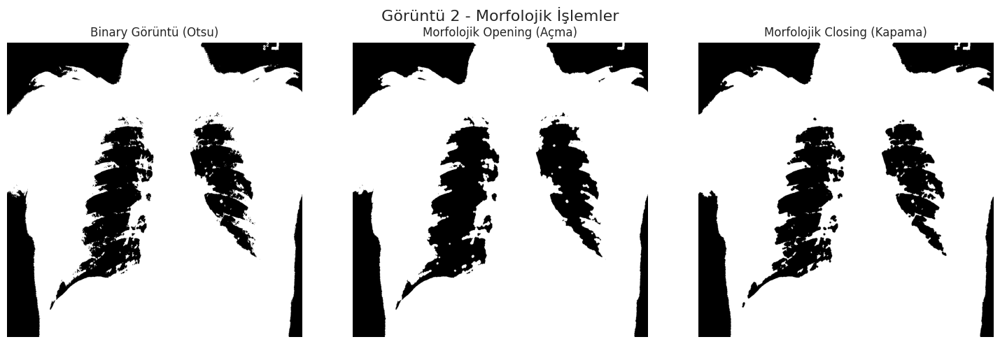

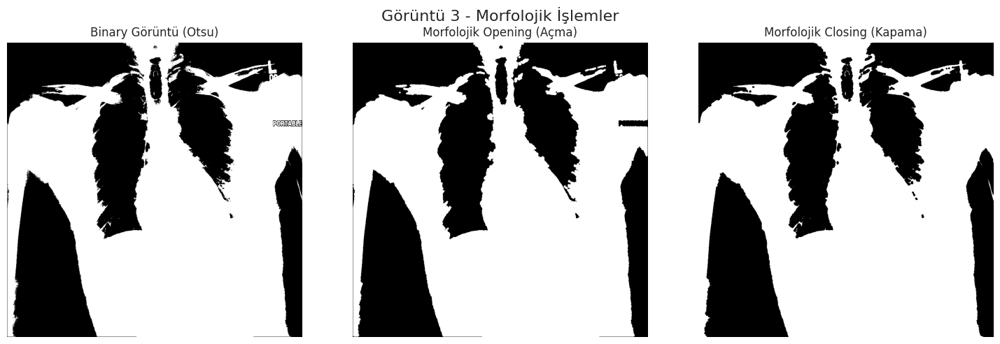

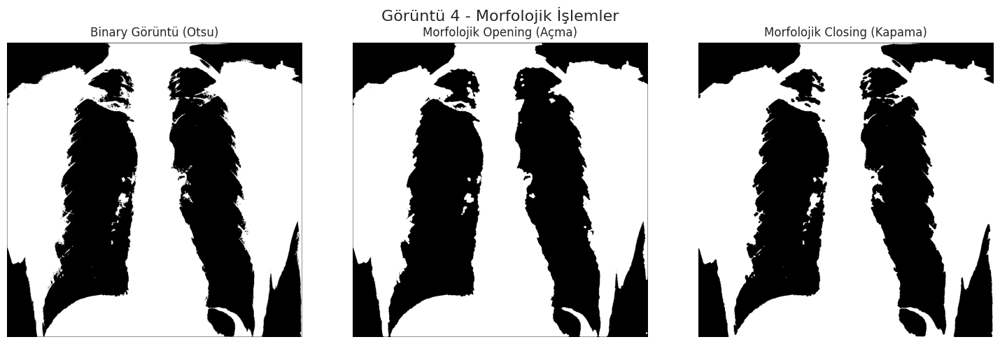

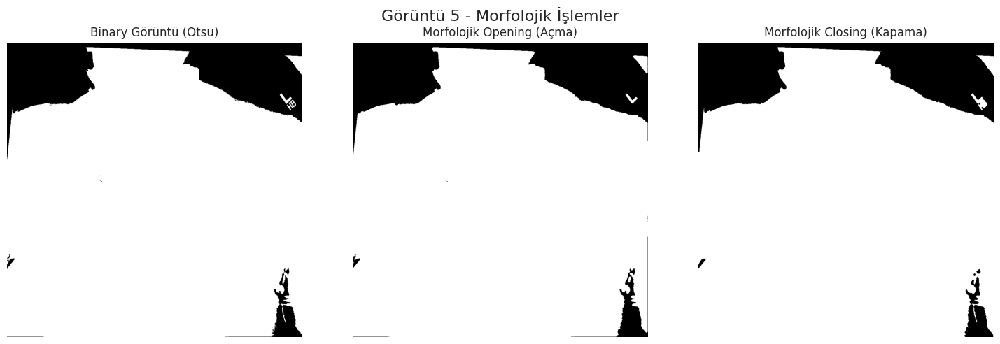

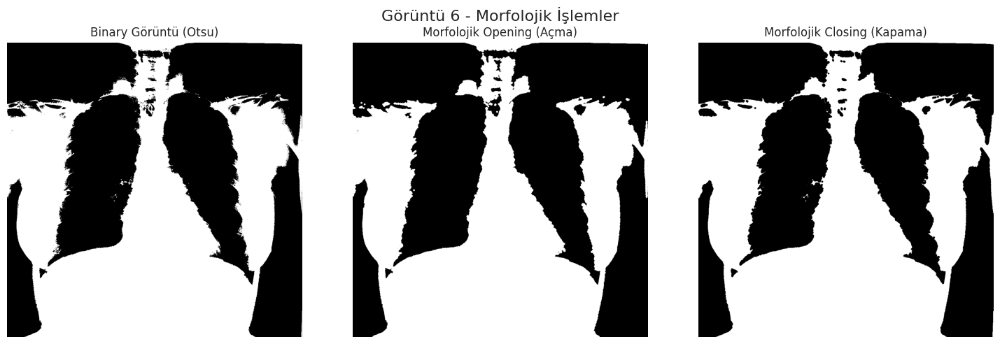

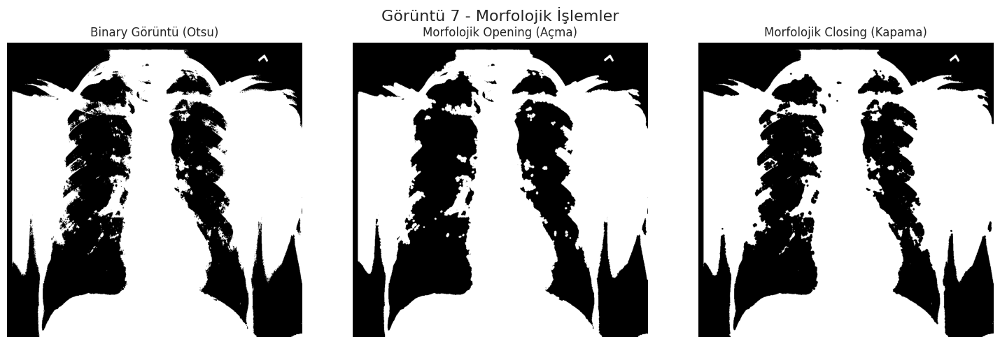

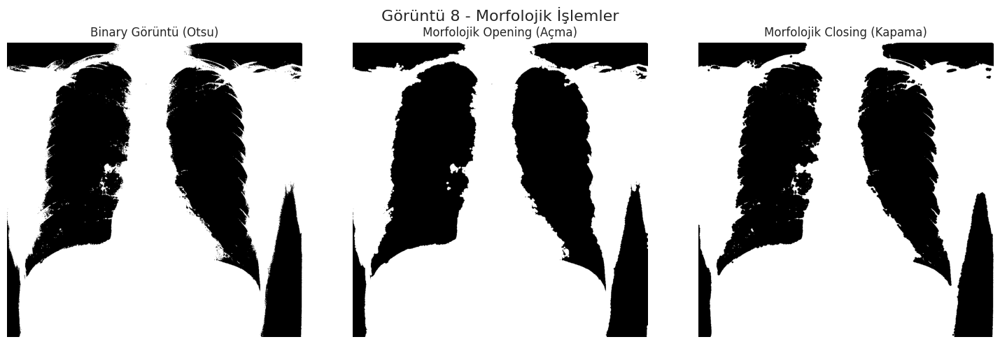

In [34]:
from skimage import color
from skimage.filters import threshold_otsu
from skimage.morphology import opening, closing, disk

for i in range(9):
    # Görüntüyü yükle
    sample_img = train_df.Image[i]
    image = plt.imread(os.path.join(img_dir, sample_img))

    # Eğer görüntü renkliyse, gri tonlamaya çeviriyoruz
    if image.ndim == 3:
        image = color.rgb2gray(image)

    # Otsu eşikleme yöntemiyle binary görüntü elde edelim
    otsu_thresh = threshold_otsu(image)
    binary_image = image > otsu_thresh

    # Uygun yapısal eleman: Disk (daire) - yarıçapı 3
    selem = disk(3)

    # Morfolojik işlemler:
    # Açma: Küçük gürültülerin/nesnelerin kaldırılması için (erosyon → dilation)
    opened_image = opening(binary_image, footprint=selem)

    # Kapama: Nesne içindeki boşlukların doldurulması için (dilation → erosion)
    closed_image = closing(binary_image, footprint=selem)

    # Görselleştirme
    plt.figure(figsize=(15, 5))

    # Giriş: Otsu ile elde edilen binary görüntü
    plt.subplot(1, 3, 1)
    plt.imshow(binary_image, cmap='gray')
    plt.title("Binary Görüntü (Otsu)")
    plt.axis('off')

    # Çıkış: Morfolojik Opening (Açma)
    plt.subplot(1, 3, 2)
    plt.imshow(opened_image, cmap='gray')
    plt.title("Morfolojik Opening (Açma)")
    plt.axis('off')

    # Çıkış: Morfolojik Closing (Kapama)
    plt.subplot(1, 3, 3)
    plt.imshow(closed_image, cmap='gray')
    plt.title("Morfolojik Closing (Kapama)")
    plt.axis('off')

    plt.suptitle(f"Görüntü {i} - Morfolojik İşlemler", fontsize=16)
    plt.tight_layout()
    plt.show()

Görüntü 0: Arka plan hariç 268 adet bölge tespit edildi.


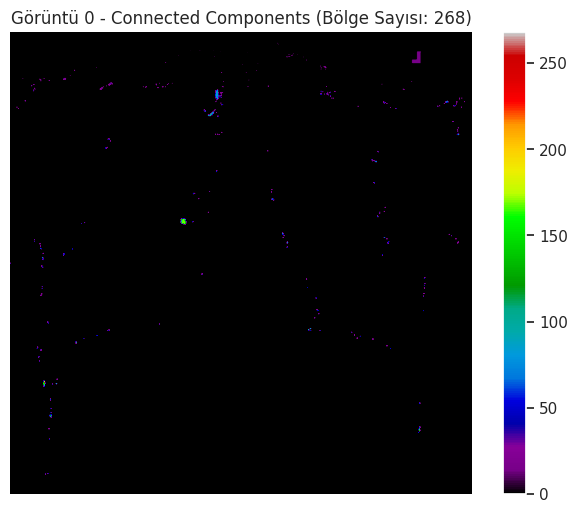

Görüntü 1: Arka plan hariç 709 adet bölge tespit edildi.


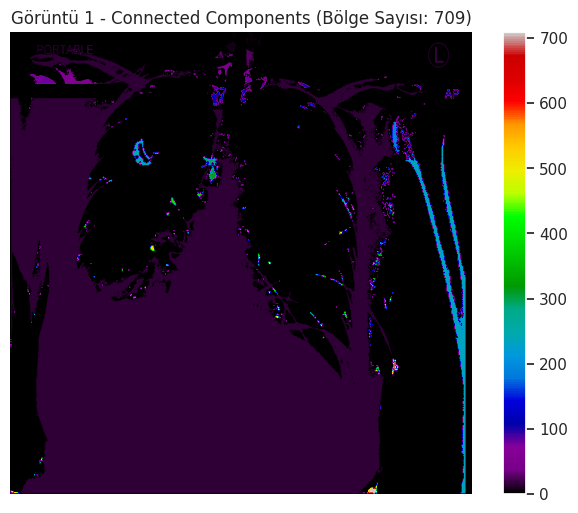

Görüntü 2: Arka plan hariç 290 adet bölge tespit edildi.


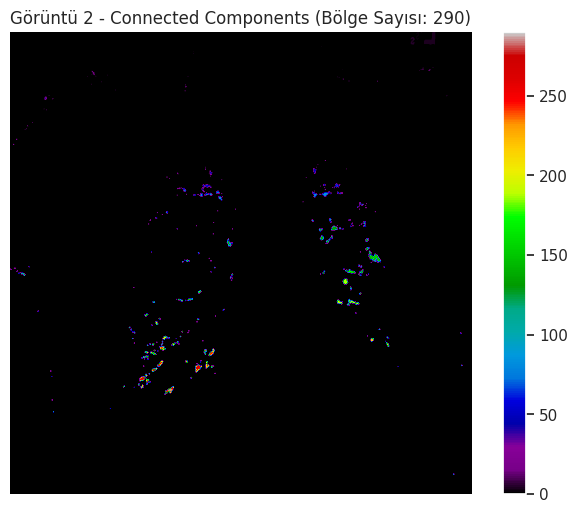

Görüntü 3: Arka plan hariç 299 adet bölge tespit edildi.


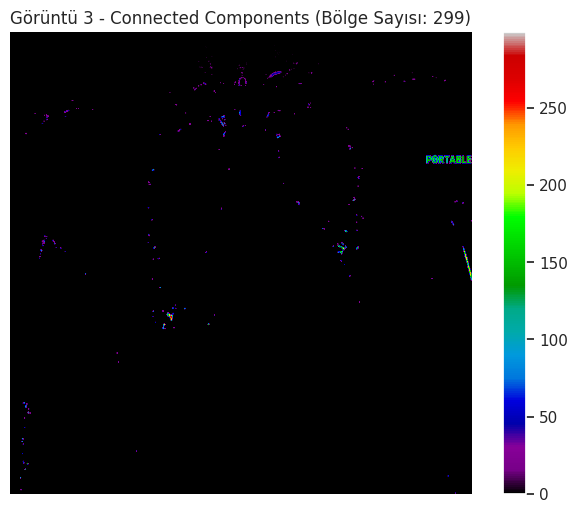

Görüntü 4: Arka plan hariç 261 adet bölge tespit edildi.


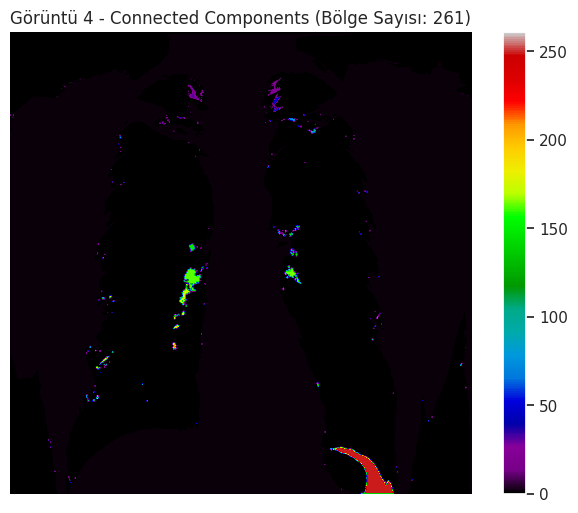

Görüntü 5: Arka plan hariç 29 adet bölge tespit edildi.


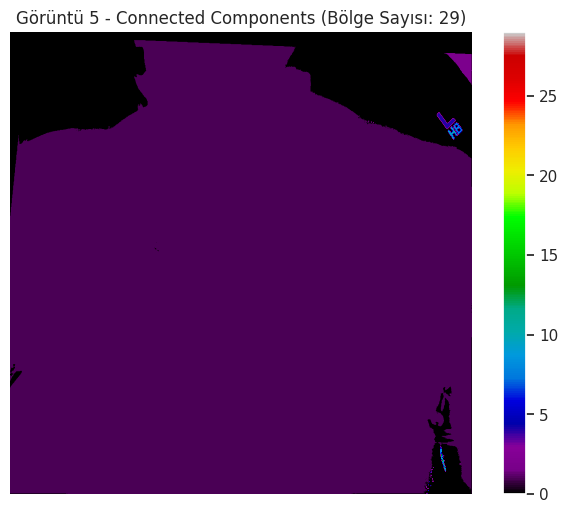

Görüntü 6: Arka plan hariç 311 adet bölge tespit edildi.


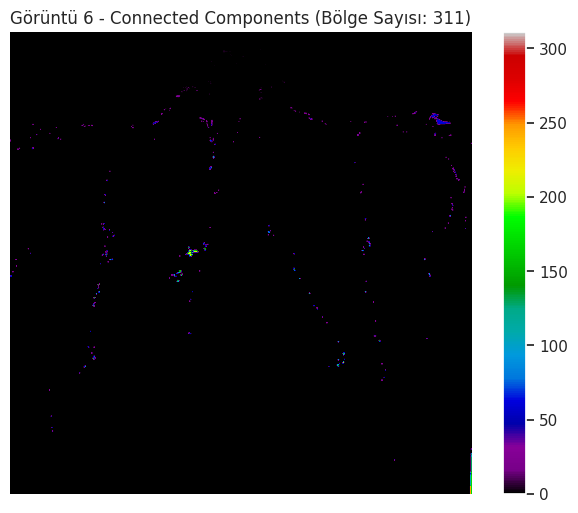

Görüntü 7: Arka plan hariç 496 adet bölge tespit edildi.


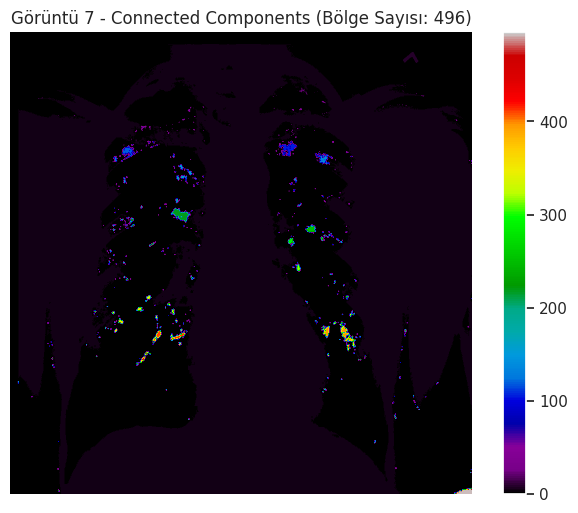

Görüntü 8: Arka plan hariç 609 adet bölge tespit edildi.


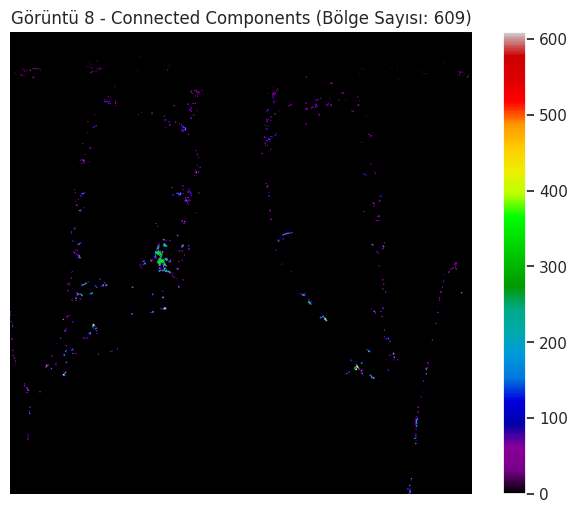

In [35]:
from skimage import color
from skimage.filters import threshold_otsu



for i in range(9):
    # Görüntüyü yükleyelim
    sample_img = train_df.Image[i]
    image = plt.imread(os.path.join(img_dir, sample_img))

    # Eğer görüntü renkliyse, gri tonlamaya çeviriyoruz
    if image.ndim == 3:
        image = color.rgb2gray(image)

    # Otsu eşikleme yöntemiyle eşik değerini belirleyip binary görüntü elde ediyoruz
    otsu_thresh = threshold_otsu(image)
    binary_image = image > otsu_thresh

    # cv2.connectedComponents için binary görüntünün uint8 ve 0-255 aralığında olması gerekir
    binary_uint8 = (binary_image.astype(np.uint8)) * 255

    # Bağlantı bileşen analizi (CCL) uygulaması
    # num_labels: Toplam etiket sayısı (arka plan dahil)
    # labels: Her piksele ait bileşen (label) değeri
    num_labels, labels = cv2.connectedComponents(binary_uint8, connectivity=8)

    # Arka plan (label 0) hariç gerçek bölge sayısını hesaplayalım
    region_count = num_labels - 1
    print(f"Görüntü {i}: Arka plan hariç {region_count} adet bölge tespit edildi.")

    # CCL çıktısını görselleştirme:
    # labels matrisi, her bileşene farklı bir tamsayı değeri verir. Bu matrisi renkli colormap ile gösterelim.
    plt.figure(figsize=(8, 6))
    plt.imshow(labels, cmap='nipy_spectral')
    plt.title(f"Görüntü {i} - Connected Components (Bölge Sayısı: {region_count})")
    plt.colorbar()
    plt.axis('off')
    plt.show()



Görüntü 0 için Bölge Özellikleri:
Label:  1 | Area: 552949 | Centroid: [601.36 505.73] | Mean Intensity: 0.71 | Eccentricity: 0.34 | Solidity: 0.55
Label:  2 | Area:    1 | Centroid: [ 16. 405.] | Mean Intensity: 0.47 | Eccentricity: 0.00 | Solidity: 1.00
Label:  3 | Area:    1 | Centroid: [ 17. 438.] | Mean Intensity: 0.47 | Eccentricity: 0.00 | Solidity: 1.00
Label:  4 | Area:    1 | Centroid: [ 18. 468.] | Mean Intensity: 0.47 | Eccentricity: 0.00 | Solidity: 1.00
Label:  5 | Area:    1 | Centroid: [ 22. 414.] | Mean Intensity: 0.48 | Eccentricity: 0.00 | Solidity: 1.00
Label:  6 | Area:    1 | Centroid: [ 22. 592.] | Mean Intensity: 0.47 | Eccentricity: 0.00 | Solidity: 1.00
Label:  7 | Area:    9 | Centroid: [ 25.56 593.44] | Mean Intensity: 0.47 | Eccentricity: 0.93 | Solidity: 0.90
Label:  8 | Area:    1 | Centroid: [ 32. 516.] | Mean Intensity: 0.47 | Eccentricity: 0.00 | Solidity: 1.00
Label:  9 | Area:    1 | Centroid: [ 37. 423.] | Mean Intensity: 0.47 | Eccentricity: 0.00 

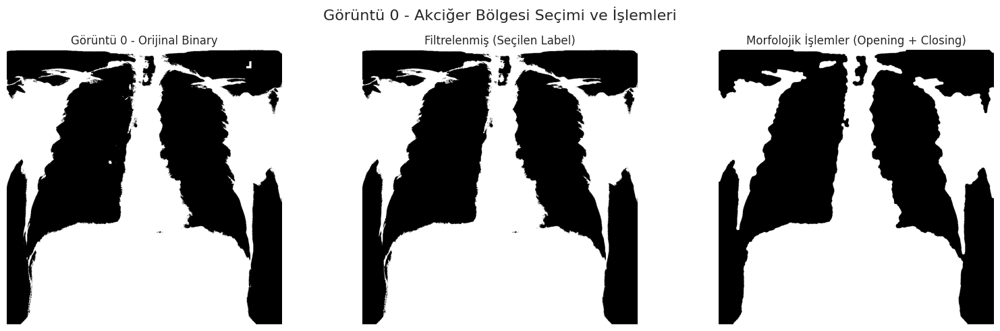


Görüntü 1 için Bölge Özellikleri:
Label:  1 | Area: 1637 | Centroid: [65.42  8.54] | Mean Intensity: 0.71 | Eccentricity: 0.99 | Solidity: 0.79
Label:  2 | Area:  120 | Centroid: [  7.58 464.45] | Mean Intensity: 0.51 | Eccentricity: 0.91 | Solidity: 0.79
Label:  3 | Area:  132 | Centroid: [  5.83 496.6 ] | Mean Intensity: 0.50 | Eccentricity: 0.32 | Solidity: 0.79
Label:  4 | Area:  256 | Centroid: [ 11.58 536.  ] | Mean Intensity: 0.52 | Eccentricity: 0.79 | Solidity: 0.70
Label:  5 | Area:    4 | Centroid: [  2.  558.5] | Mean Intensity: 0.49 | Eccentricity: 0.92 | Solidity: 1.00
Label:  6 | Area:   96 | Centroid: [ 19.55 553.43] | Mean Intensity: 0.49 | Eccentricity: 0.95 | Solidity: 0.52
Label:  7 | Area:   34 | Centroid: [ 17.09 525.35] | Mean Intensity: 0.49 | Eccentricity: 0.68 | Solidity: 0.77
Label:  8 | Area:    4 | Centroid: [ 20.5 529.5] | Mean Intensity: 0.49 | Eccentricity: 0.00 | Solidity: 1.00
Label:  9 | Area:  332 | Centroid: [ 32.04 490.46] | Mean Intensity: 0.52 |

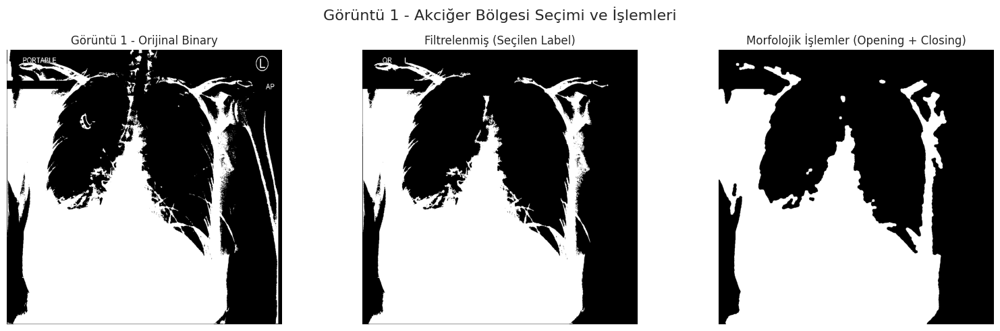


Görüntü 2 için Bölge Özellikleri:
Label:  1 | Area: 772993 | Centroid: [537.2  537.43] | Mean Intensity: 0.73 | Eccentricity: 0.28 | Solidity: 0.81
Label:  2 | Area:   78 | Centroid: [  8.01 903.14] | Mean Intensity: 0.74 | Eccentricity: 0.92 | Solidity: 0.64
Label:  3 | Area:    5 | Centroid: [4.000e-01 9.118e+02] | Mean Intensity: 0.69 | Eccentricity: 0.82 | Solidity: 1.00
Label:  4 | Area:  388 | Centroid: [ 16.97 932.43] | Mean Intensity: 0.80 | Eccentricity: 0.83 | Solidity: 0.73
Label:  5 | Area:  107 | Centroid: [ 19.24 891.97] | Mean Intensity: 0.76 | Eccentricity: 0.88 | Solidity: 0.76
Label:  6 | Area:    1 | Centroid: [ 12. 420.] | Mean Intensity: 0.56 | Eccentricity: 0.00 | Solidity: 1.00
Label:  7 | Area:    1 | Centroid: [ 31. 690.] | Mean Intensity: 0.56 | Eccentricity: 0.00 | Solidity: 1.00
Label:  8 | Area:    1 | Centroid: [ 43. 406.] | Mean Intensity: 0.56 | Eccentricity: 0.00 | Solidity: 1.00
Label:  9 | Area:    2 | Centroid: [ 47.5 406. ] | Mean Intensity: 0.56 |

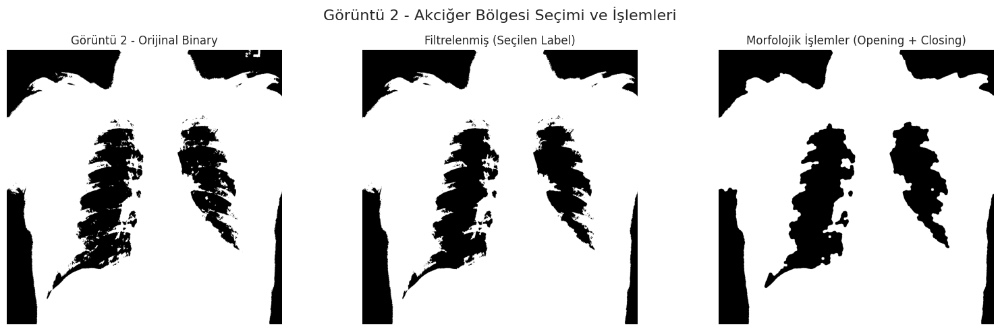


Görüntü 3 için Bölge Özellikleri:
Label:  1 | Area: 629827 | Centroid: [573.39 556.41] | Mean Intensity: 0.59 | Eccentricity: 0.40 | Solidity: 0.65
Label:  2 | Area:    1 | Centroid: [  3. 596.] | Mean Intensity: 0.40 | Eccentricity: 0.00 | Solidity: 1.00
Label:  3 | Area:    1 | Centroid: [  3. 601.] | Mean Intensity: 0.40 | Eccentricity: 0.00 | Solidity: 1.00
Label:  4 | Area:    2 | Centroid: [  9.5 596. ] | Mean Intensity: 0.40 | Eccentricity: 1.00 | Solidity: 1.00
Label:  5 | Area:    1 | Centroid: [ 17. 591.] | Mean Intensity: 0.40 | Eccentricity: 0.00 | Solidity: 1.00
Label:  6 | Area:    2 | Centroid: [ 18.5 511. ] | Mean Intensity: 0.40 | Eccentricity: 1.00 | Solidity: 1.00
Label:  7 | Area:    1 | Centroid: [ 22. 584.] | Mean Intensity: 0.40 | Eccentricity: 0.00 | Solidity: 1.00
Label:  8 | Area:    1 | Centroid: [ 23. 429.] | Mean Intensity: 0.40 | Eccentricity: 0.00 | Solidity: 1.00
Label:  9 | Area:    1 | Centroid: [ 30. 586.] | Mean Intensity: 0.40 | Eccentricity: 0.00 

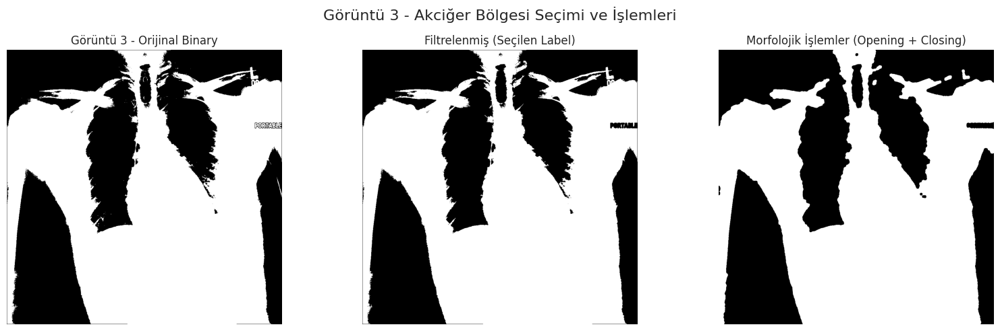


Görüntü 4 için Bölge Özellikleri:
Label:  1 | Area: 586124 | Centroid: [509.61 515.36] | Mean Intensity: 0.79 | Eccentricity: 0.40 | Solidity: 0.59
Label:  2 | Area:    3 | Centroid: [  5. 343.] | Mean Intensity: 0.61 | Eccentricity: 1.00 | Solidity: 1.00
Label:  3 | Area:    2 | Centroid: [ 36.  638.5] | Mean Intensity: 0.61 | Eccentricity: 1.00 | Solidity: 1.00
Label:  4 | Area:    5 | Centroid: [ 59.8 815.2] | Mean Intensity: 0.61 | Eccentricity: 0.88 | Solidity: 0.71
Label:  5 | Area:    1 | Centroid: [ 60. 812.] | Mean Intensity: 0.61 | Eccentricity: 0.00 | Solidity: 1.00
Label:  6 | Area:    1 | Centroid: [ 66. 853.] | Mean Intensity: 0.61 | Eccentricity: 0.00 | Solidity: 1.00
Label:  7 | Area:    2 | Centroid: [ 67.5 850. ] | Mean Intensity: 0.61 | Eccentricity: 1.00 | Solidity: 1.00
Label:  8 | Area:    1 | Centroid: [ 68. 852.] | Mean Intensity: 0.61 | Eccentricity: 0.00 | Solidity: 1.00
Label:  9 | Area:    5 | Centroid: [ 69.2 856.2] | Mean Intensity: 0.61 | Eccentricity: 0

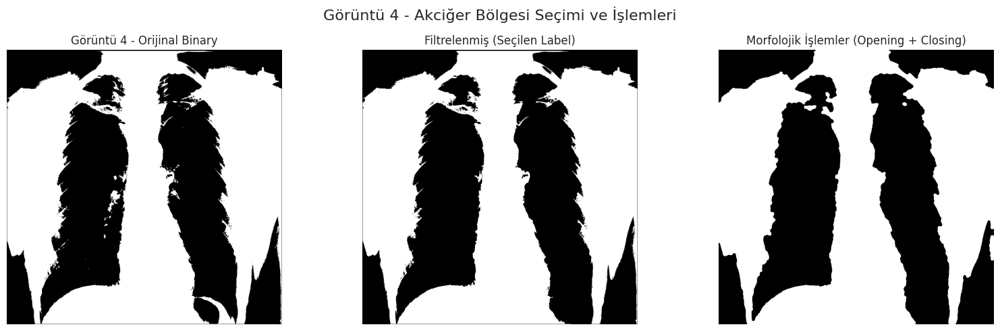


Görüntü 5 için Bölge Özellikleri:
Label:  1 | Area: 885368 | Centroid: [575.8  503.46] | Mean Intensity: 0.67 | Eccentricity: 0.37 | Solidity: 0.94
Label:  2 | Area: 1778 | Centroid: [  69.67 1004.38] | Mean Intensity: 0.57 | Eccentricity: 0.85 | Solidity: 0.83
Label:  3 | Area:    1 | Centroid: [160. 285.] | Mean Intensity: 0.38 | Eccentricity: 0.00 | Solidity: 1.00
Label:  4 | Area:  490 | Centroid: [197.26 965.56] | Mean Intensity: 0.71 | Eccentricity: 0.86 | Solidity: 0.63
Label:  5 | Area:    2 | Centroid: [197.  794.5] | Mean Intensity: 0.38 | Eccentricity: 1.00 | Solidity: 1.00
Label:  6 | Area:    2 | Centroid: [199.  800.5] | Mean Intensity: 0.38 | Eccentricity: 1.00 | Solidity: 1.00
Label:  7 | Area:    1 | Centroid: [200. 805.] | Mean Intensity: 0.38 | Eccentricity: 0.00 | Solidity: 1.00
Label:  8 | Area:  227 | Centroid: [212.91 991.95] | Mean Intensity: 0.71 | Eccentricity: 0.82 | Solidity: 0.76
Label:  9 | Area:    1 | Centroid: [210. 219.] | Mean Intensity: 0.38 | Eccen

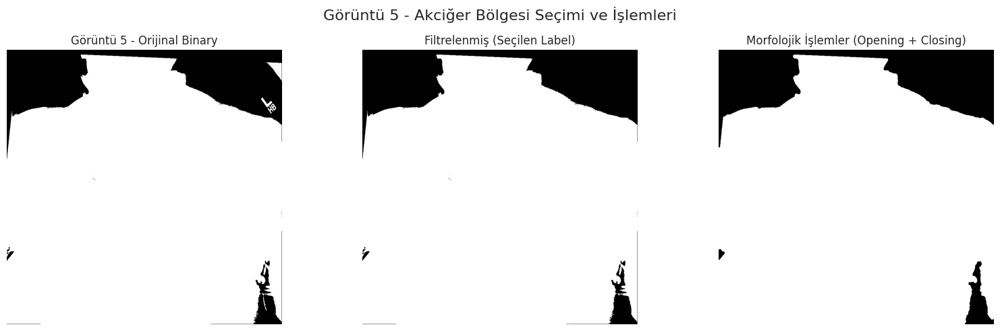


Görüntü 6 için Bölge Özellikleri:
Label:  1 | Area: 524962 | Centroid: [621.34 485.96] | Mean Intensity: 0.66 | Eccentricity: 0.29 | Solidity: 0.55
Label:  2 | Area:    1 | Centroid: [ 31. 478.] | Mean Intensity: 0.42 | Eccentricity: 0.00 | Solidity: 1.00
Label:  3 | Area:    2 | Centroid: [ 38.  554.5] | Mean Intensity: 0.43 | Eccentricity: 1.00 | Solidity: 1.00
Label:  4 | Area:    2 | Centroid: [ 39.  445.5] | Mean Intensity: 0.42 | Eccentricity: 1.00 | Solidity: 1.00
Label:  5 | Area:   28 | Centroid: [ 42.36 475.71] | Mean Intensity: 0.43 | Eccentricity: 0.91 | Solidity: 0.65
Label:  6 | Area:    1 | Centroid: [ 42. 484.] | Mean Intensity: 0.42 | Eccentricity: 0.00 | Solidity: 1.00
Label:  7 | Area:    3 | Centroid: [ 43. 487.] | Mean Intensity: 0.42 | Eccentricity: 1.00 | Solidity: 1.00
Label:  8 | Area:    2 | Centroid: [ 49.5 489. ] | Mean Intensity: 0.42 | Eccentricity: 1.00 | Solidity: 1.00
Label:  9 | Area:    1 | Centroid: [ 52. 490.] | Mean Intensity: 0.42 | Eccentricity:

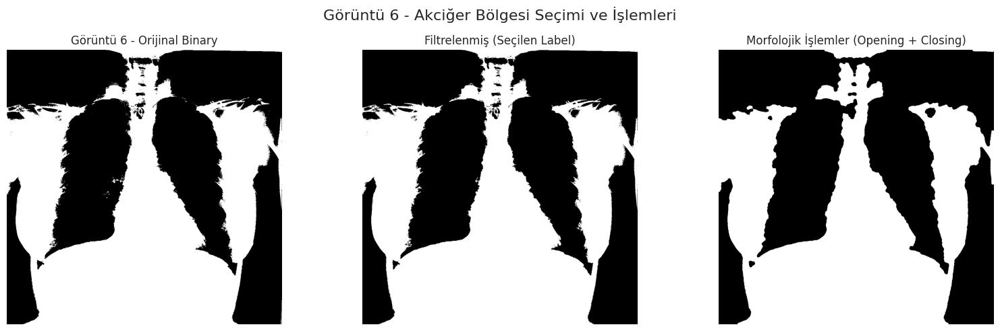


Görüntü 7 için Bölge Özellikleri:
Label:  1 | Area: 596151 | Centroid: [538.07 530.7 ] | Mean Intensity: 0.65 | Eccentricity: 0.31 | Solidity: 0.65
Label:  2 | Area:    1 | Centroid: [ 27. 338.] | Mean Intensity: 0.48 | Eccentricity: 0.00 | Solidity: 1.00
Label:  3 | Area:    1 | Centroid: [ 27. 341.] | Mean Intensity: 0.48 | Eccentricity: 0.00 | Solidity: 1.00
Label:  4 | Area:    1 | Centroid: [ 27. 343.] | Mean Intensity: 0.48 | Eccentricity: 0.00 | Solidity: 1.00
Label:  5 | Area:    3 | Centroid: [ 31.   625.67] | Mean Intensity: 0.48 | Eccentricity: 0.97 | Solidity: 0.75
Label:  6 | Area:   11 | Centroid: [ 32.55 618.36] | Mean Intensity: 0.48 | Eccentricity: 0.89 | Solidity: 0.73
Label:  7 | Area:    1 | Centroid: [ 36. 617.] | Mean Intensity: 0.48 | Eccentricity: 0.00 | Solidity: 1.00
Label:  8 | Area:    2 | Centroid: [ 38.5 619. ] | Mean Intensity: 0.48 | Eccentricity: 1.00 | Solidity: 1.00
Label:  9 | Area:  360 | Centroid: [ 56.55 888.59] | Mean Intensity: 0.62 | Eccentric

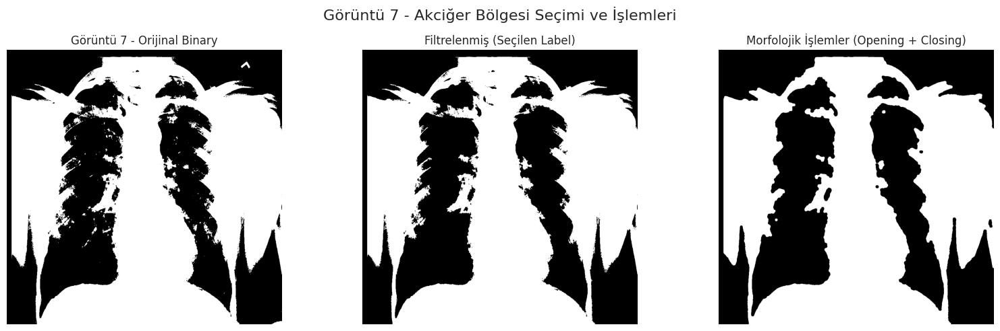


Görüntü 8 için Bölge Özellikleri:
Label:  1 | Area:    3 | Centroid: [  0. 356.] | Mean Intensity: 0.42 | Eccentricity: 1.00 | Solidity: 1.00
Label:  2 | Area: 632546 | Centroid: [570.95 501.83] | Mean Intensity: 0.52 | Eccentricity: 0.41 | Solidity: 0.62
Label:  3 | Area:    3 | Centroid: [  0. 771.] | Mean Intensity: 0.42 | Eccentricity: 1.00 | Solidity: 1.00
Label:  4 | Area:    1 | Centroid: [  0. 948.] | Mean Intensity: 0.42 | Eccentricity: 0.00 | Solidity: 1.00
Label:  5 | Area:    3 | Centroid: [  0. 952.] | Mean Intensity: 0.42 | Eccentricity: 1.00 | Solidity: 1.00
Label:  6 | Area:    5 | Centroid: [  0. 957.] | Mean Intensity: 0.43 | Eccentricity: 1.00 | Solidity: 1.00
Label:  7 | Area:   92 | Centroid: [5.90000e-01 1.00073e+03] | Mean Intensity: 0.47 | Eccentricity: 1.00 | Solidity: 0.42
Label:  8 | Area:    2 | Centroid: [ 13.5 374. ] | Mean Intensity: 0.42 | Eccentricity: 1.00 | Solidity: 1.00
Label:  9 | Area:    6 | Centroid: [ 16.67 373.5 ] | Mean Intensity: 0.42 | Ecc

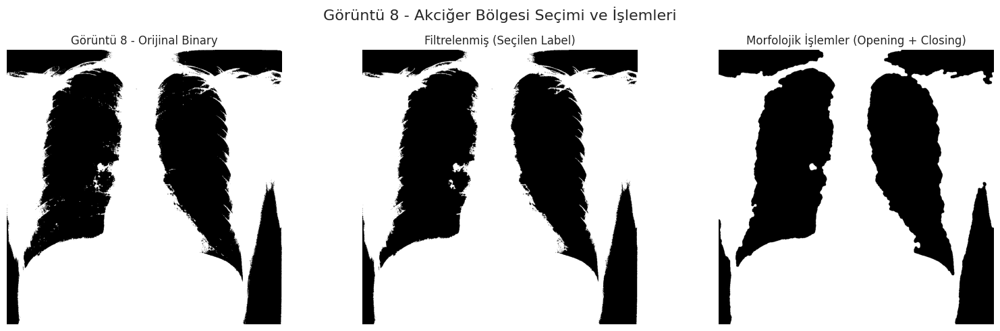

In [38]:


for i in range(9):
    # 1. Görüntüyü Yükleme ve Gri Tonlama
    sample_img = train_df.Image[i]
    image = plt.imread(os.path.join(img_dir, sample_img))
    if image.ndim == 3:
        image = color.rgb2gray(image)

    # 2. Otsu Eşikleme ile Binary Görüntü Oluşturma
    otsu_thresh = filters.threshold_otsu(image)
    binary_image = image > otsu_thresh

    # 3. Bağlantı Bileşen Analizi (Labeling)
    labels = measure.label(binary_image, connectivity=2)

    # 4. Bölge (Region) Özelliklerini Hesaplama
    # intensity_image olarak orijinal (gri) görüntüyü de vererek yoğunlukla ilgili öznitelikleri alıyoruz.
    regions = regionprops(labels, intensity_image=image)

    print(f"\nGörüntü {i} için Bölge Özellikleri:")
    for region in regions:
        # En az 5 öznitelik: Label, Area, Centroid, Mean Intensity, Eccentricity, Solidity
        print(f"Label: {int(region.label):2d} | Area: {int(region.area):4d} | Centroid: {np.round(region.centroid, 2)} | "
              f"Mean Intensity: {region.mean_intensity:.2f} | "
              f"Eccentricity: {region.eccentricity:.2f} | Solidity: {region.solidity:.2f}")

    # 5. Akciğer Alanlarını Temsil Eden Bölge(ler) Seçimi
    # Basit filtreleme: Alanlarına göre sıralayıp, yatayda (column değeri) görüntü merkezine yakın olanları seçelim.
    height, width = image.shape
    center_x = width / 2.0  # yatay merkez
    regions_sorted = sorted(regions, key=lambda r: r.area, reverse=True)

    selected_labels = []
    if len(regions_sorted) >= 2:
        # En büyük iki bölgeyi deniyoruz.
        r1 = regions_sorted[0]
        r2 = regions_sorted[1]
        # Eğer her iki bölgenin centroidi yatayda görüntü merkezine yakınsa (örn: fark < %20 genişlik)
        if abs(r1.centroid[1] - center_x) < width * 0.2 and abs(r2.centroid[1] - center_x) < width * 0.2:
            selected_labels = [r1.label, r2.label]
        else:
            selected_labels = [r1.label]
    elif regions_sorted:
        selected_labels = [regions_sorted[0].label]
    else:
        print("Hiçbir bölge tespit edilemedi!")

    print(f"Seçilen Label(lar): {selected_labels}")

    # 6. Filtrelenmiş Görüntüyü Oluşturma: Sadece seçilen label'lara ait bölgeleri koruyoruz.
    filtered_image = np.isin(labels, selected_labels)

    # 7. Morfolojik İşlemler:
    # Yapısal eleman olarak yarıçapı 5 olan disk kullanıyoruz.
    selem = morphology.disk(5)
    # Açma (gürültü giderme) ve Kapama (boşluk doldurma) işlemleri uyguluyoruz.
    morph_image = morphology.opening(filtered_image, selem)
    morph_image = morphology.closing(morph_image, selem)

    # 8. Sonuçların Görselleştirilmesi
    plt.figure(figsize=(16, 5))

    # Orijinal Binary Görüntü
    plt.subplot(1, 3, 1)
    plt.imshow(binary_image, cmap='gray')
    plt.title(f"Görüntü {i} - Orijinal Binary")
    plt.axis('off')

    # Filtrelenmiş (Seçilen Label) Görüntü
    plt.subplot(1, 3, 2)
    plt.imshow(filtered_image, cmap='gray')
    plt.title("Filtrelenmiş (Seçilen Label)")
    plt.axis('off')

    # Morfolojik İşlemler Sonrası Görüntü
    plt.subplot(1, 3, 3)
    plt.imshow(morph_image, cmap='gray')
    plt.title("Morfolojik İşlemler (Opening + Closing)")
    plt.axis('off')

    plt.suptitle(f"Görüntü {i} - Akciğer Bölgesi Seçimi ve İşlemleri", fontsize=16)
    plt.tight_layout()
    plt.show()



Görüntü 0 için Bölge Özellikleri:
Label:  1 | Area: 552949 | Centroid: [601.36 505.73] | Mean Intensity: 0.71 | Eccentricity: 0.34 | Solidity: 0.55
Label:  2 | Area:    1 | Centroid: [ 16. 405.] | Mean Intensity: 0.47 | Eccentricity: 0.00 | Solidity: 1.00
Label:  3 | Area:    1 | Centroid: [ 17. 438.] | Mean Intensity: 0.47 | Eccentricity: 0.00 | Solidity: 1.00
Label:  4 | Area:    1 | Centroid: [ 18. 468.] | Mean Intensity: 0.47 | Eccentricity: 0.00 | Solidity: 1.00
Label:  5 | Area:    1 | Centroid: [ 22. 414.] | Mean Intensity: 0.48 | Eccentricity: 0.00 | Solidity: 1.00
Label:  6 | Area:    1 | Centroid: [ 22. 592.] | Mean Intensity: 0.47 | Eccentricity: 0.00 | Solidity: 1.00
Label:  7 | Area:    9 | Centroid: [ 25.56 593.44] | Mean Intensity: 0.47 | Eccentricity: 0.93 | Solidity: 0.90
Label:  8 | Area:    1 | Centroid: [ 32. 516.] | Mean Intensity: 0.47 | Eccentricity: 0.00 | Solidity: 1.00
Label:  9 | Area:    1 | Centroid: [ 37. 423.] | Mean Intensity: 0.47 | Eccentricity: 0.00 

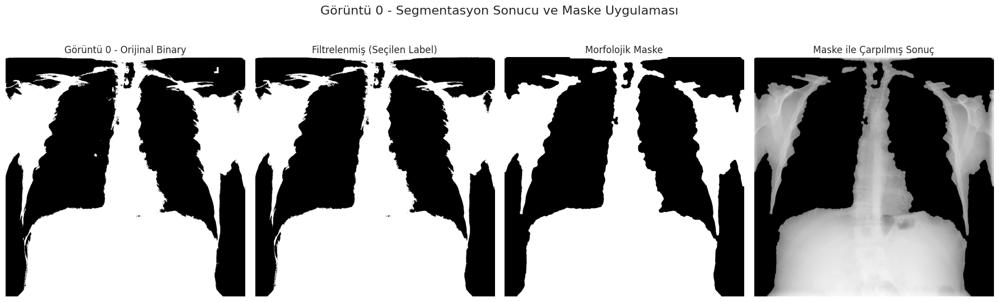


Görüntü 1 için Bölge Özellikleri:
Label:  1 | Area: 1637 | Centroid: [65.42  8.54] | Mean Intensity: 0.71 | Eccentricity: 0.99 | Solidity: 0.79
Label:  2 | Area:  120 | Centroid: [  7.58 464.45] | Mean Intensity: 0.51 | Eccentricity: 0.91 | Solidity: 0.79
Label:  3 | Area:  132 | Centroid: [  5.83 496.6 ] | Mean Intensity: 0.50 | Eccentricity: 0.32 | Solidity: 0.79
Label:  4 | Area:  256 | Centroid: [ 11.58 536.  ] | Mean Intensity: 0.52 | Eccentricity: 0.79 | Solidity: 0.70
Label:  5 | Area:    4 | Centroid: [  2.  558.5] | Mean Intensity: 0.49 | Eccentricity: 0.92 | Solidity: 1.00
Label:  6 | Area:   96 | Centroid: [ 19.55 553.43] | Mean Intensity: 0.49 | Eccentricity: 0.95 | Solidity: 0.52
Label:  7 | Area:   34 | Centroid: [ 17.09 525.35] | Mean Intensity: 0.49 | Eccentricity: 0.68 | Solidity: 0.77
Label:  8 | Area:    4 | Centroid: [ 20.5 529.5] | Mean Intensity: 0.49 | Eccentricity: 0.00 | Solidity: 1.00
Label:  9 | Area:  332 | Centroid: [ 32.04 490.46] | Mean Intensity: 0.52 |

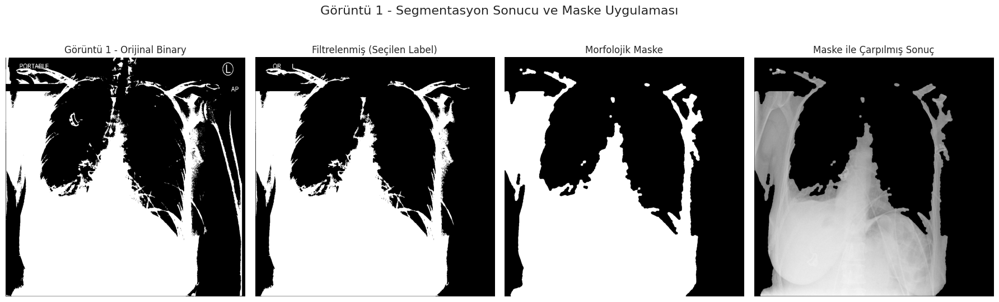


Görüntü 2 için Bölge Özellikleri:
Label:  1 | Area: 772993 | Centroid: [537.2  537.43] | Mean Intensity: 0.73 | Eccentricity: 0.28 | Solidity: 0.81
Label:  2 | Area:   78 | Centroid: [  8.01 903.14] | Mean Intensity: 0.74 | Eccentricity: 0.92 | Solidity: 0.64
Label:  3 | Area:    5 | Centroid: [4.000e-01 9.118e+02] | Mean Intensity: 0.69 | Eccentricity: 0.82 | Solidity: 1.00
Label:  4 | Area:  388 | Centroid: [ 16.97 932.43] | Mean Intensity: 0.80 | Eccentricity: 0.83 | Solidity: 0.73
Label:  5 | Area:  107 | Centroid: [ 19.24 891.97] | Mean Intensity: 0.76 | Eccentricity: 0.88 | Solidity: 0.76
Label:  6 | Area:    1 | Centroid: [ 12. 420.] | Mean Intensity: 0.56 | Eccentricity: 0.00 | Solidity: 1.00
Label:  7 | Area:    1 | Centroid: [ 31. 690.] | Mean Intensity: 0.56 | Eccentricity: 0.00 | Solidity: 1.00
Label:  8 | Area:    1 | Centroid: [ 43. 406.] | Mean Intensity: 0.56 | Eccentricity: 0.00 | Solidity: 1.00
Label:  9 | Area:    2 | Centroid: [ 47.5 406. ] | Mean Intensity: 0.56 |

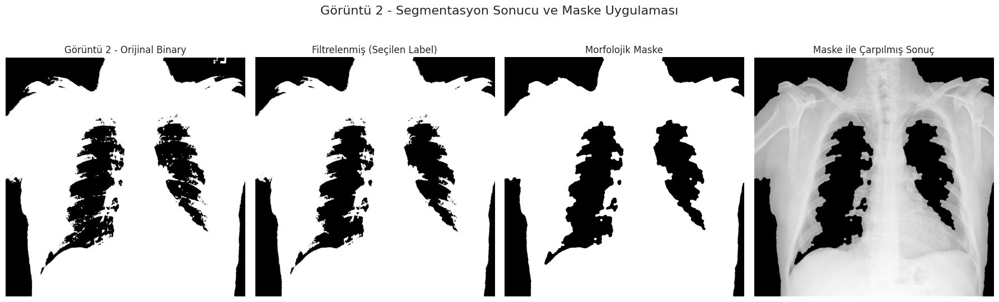


Görüntü 3 için Bölge Özellikleri:
Label:  1 | Area: 629827 | Centroid: [573.39 556.41] | Mean Intensity: 0.59 | Eccentricity: 0.40 | Solidity: 0.65
Label:  2 | Area:    1 | Centroid: [  3. 596.] | Mean Intensity: 0.40 | Eccentricity: 0.00 | Solidity: 1.00
Label:  3 | Area:    1 | Centroid: [  3. 601.] | Mean Intensity: 0.40 | Eccentricity: 0.00 | Solidity: 1.00
Label:  4 | Area:    2 | Centroid: [  9.5 596. ] | Mean Intensity: 0.40 | Eccentricity: 1.00 | Solidity: 1.00
Label:  5 | Area:    1 | Centroid: [ 17. 591.] | Mean Intensity: 0.40 | Eccentricity: 0.00 | Solidity: 1.00
Label:  6 | Area:    2 | Centroid: [ 18.5 511. ] | Mean Intensity: 0.40 | Eccentricity: 1.00 | Solidity: 1.00
Label:  7 | Area:    1 | Centroid: [ 22. 584.] | Mean Intensity: 0.40 | Eccentricity: 0.00 | Solidity: 1.00
Label:  8 | Area:    1 | Centroid: [ 23. 429.] | Mean Intensity: 0.40 | Eccentricity: 0.00 | Solidity: 1.00
Label:  9 | Area:    1 | Centroid: [ 30. 586.] | Mean Intensity: 0.40 | Eccentricity: 0.00 

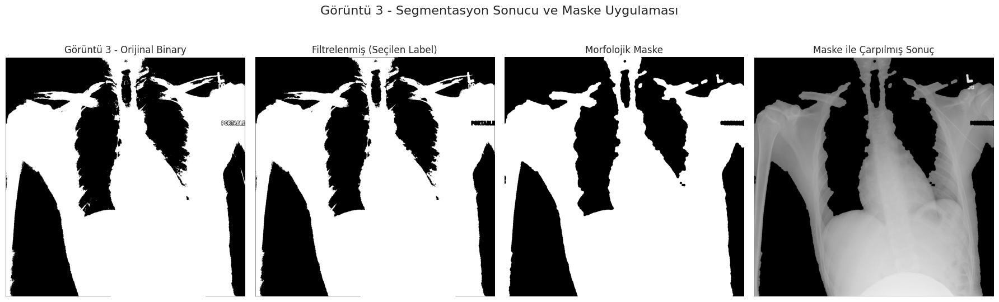


Görüntü 4 için Bölge Özellikleri:
Label:  1 | Area: 586124 | Centroid: [509.61 515.36] | Mean Intensity: 0.79 | Eccentricity: 0.40 | Solidity: 0.59
Label:  2 | Area:    3 | Centroid: [  5. 343.] | Mean Intensity: 0.61 | Eccentricity: 1.00 | Solidity: 1.00
Label:  3 | Area:    2 | Centroid: [ 36.  638.5] | Mean Intensity: 0.61 | Eccentricity: 1.00 | Solidity: 1.00
Label:  4 | Area:    5 | Centroid: [ 59.8 815.2] | Mean Intensity: 0.61 | Eccentricity: 0.88 | Solidity: 0.71
Label:  5 | Area:    1 | Centroid: [ 60. 812.] | Mean Intensity: 0.61 | Eccentricity: 0.00 | Solidity: 1.00
Label:  6 | Area:    1 | Centroid: [ 66. 853.] | Mean Intensity: 0.61 | Eccentricity: 0.00 | Solidity: 1.00
Label:  7 | Area:    2 | Centroid: [ 67.5 850. ] | Mean Intensity: 0.61 | Eccentricity: 1.00 | Solidity: 1.00
Label:  8 | Area:    1 | Centroid: [ 68. 852.] | Mean Intensity: 0.61 | Eccentricity: 0.00 | Solidity: 1.00
Label:  9 | Area:    5 | Centroid: [ 69.2 856.2] | Mean Intensity: 0.61 | Eccentricity: 0

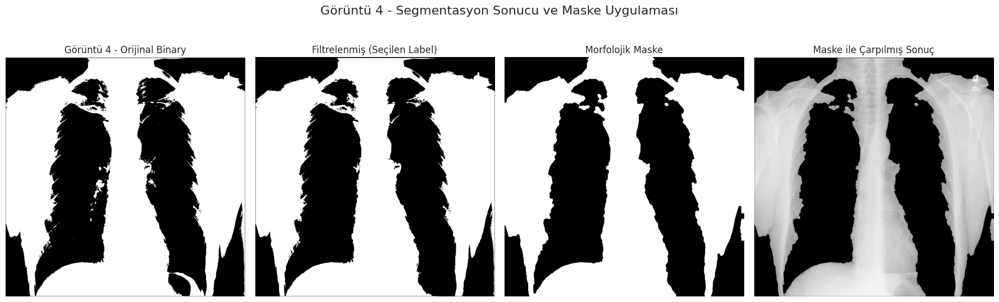


Görüntü 5 için Bölge Özellikleri:
Label:  1 | Area: 885368 | Centroid: [575.8  503.46] | Mean Intensity: 0.67 | Eccentricity: 0.37 | Solidity: 0.94
Label:  2 | Area: 1778 | Centroid: [  69.67 1004.38] | Mean Intensity: 0.57 | Eccentricity: 0.85 | Solidity: 0.83
Label:  3 | Area:    1 | Centroid: [160. 285.] | Mean Intensity: 0.38 | Eccentricity: 0.00 | Solidity: 1.00
Label:  4 | Area:  490 | Centroid: [197.26 965.56] | Mean Intensity: 0.71 | Eccentricity: 0.86 | Solidity: 0.63
Label:  5 | Area:    2 | Centroid: [197.  794.5] | Mean Intensity: 0.38 | Eccentricity: 1.00 | Solidity: 1.00
Label:  6 | Area:    2 | Centroid: [199.  800.5] | Mean Intensity: 0.38 | Eccentricity: 1.00 | Solidity: 1.00
Label:  7 | Area:    1 | Centroid: [200. 805.] | Mean Intensity: 0.38 | Eccentricity: 0.00 | Solidity: 1.00
Label:  8 | Area:  227 | Centroid: [212.91 991.95] | Mean Intensity: 0.71 | Eccentricity: 0.82 | Solidity: 0.76
Label:  9 | Area:    1 | Centroid: [210. 219.] | Mean Intensity: 0.38 | Eccen

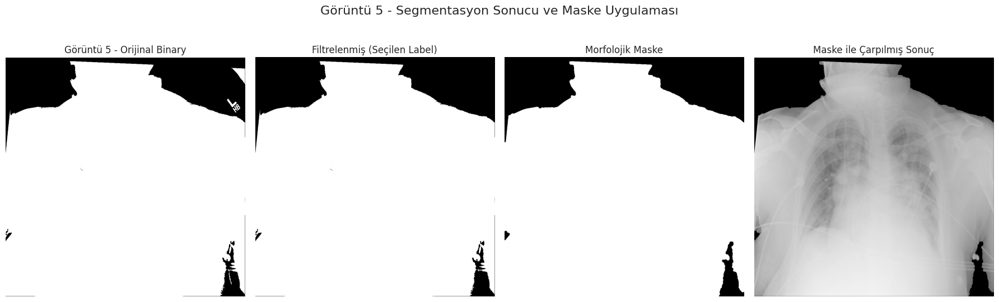


Görüntü 6 için Bölge Özellikleri:
Label:  1 | Area: 524962 | Centroid: [621.34 485.96] | Mean Intensity: 0.66 | Eccentricity: 0.29 | Solidity: 0.55
Label:  2 | Area:    1 | Centroid: [ 31. 478.] | Mean Intensity: 0.42 | Eccentricity: 0.00 | Solidity: 1.00
Label:  3 | Area:    2 | Centroid: [ 38.  554.5] | Mean Intensity: 0.43 | Eccentricity: 1.00 | Solidity: 1.00
Label:  4 | Area:    2 | Centroid: [ 39.  445.5] | Mean Intensity: 0.42 | Eccentricity: 1.00 | Solidity: 1.00
Label:  5 | Area:   28 | Centroid: [ 42.36 475.71] | Mean Intensity: 0.43 | Eccentricity: 0.91 | Solidity: 0.65
Label:  6 | Area:    1 | Centroid: [ 42. 484.] | Mean Intensity: 0.42 | Eccentricity: 0.00 | Solidity: 1.00
Label:  7 | Area:    3 | Centroid: [ 43. 487.] | Mean Intensity: 0.42 | Eccentricity: 1.00 | Solidity: 1.00
Label:  8 | Area:    2 | Centroid: [ 49.5 489. ] | Mean Intensity: 0.42 | Eccentricity: 1.00 | Solidity: 1.00
Label:  9 | Area:    1 | Centroid: [ 52. 490.] | Mean Intensity: 0.42 | Eccentricity:

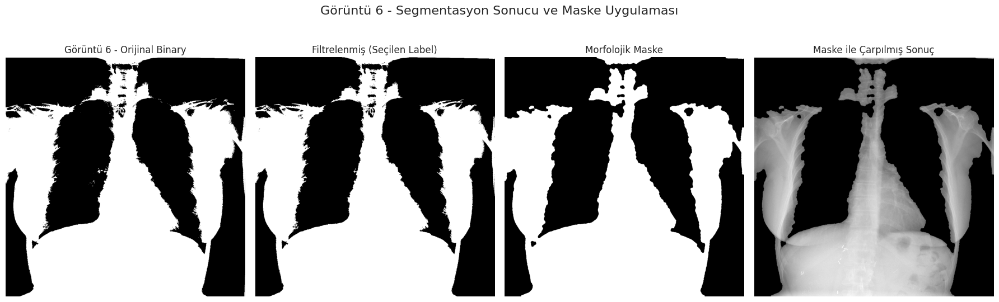


Görüntü 7 için Bölge Özellikleri:
Label:  1 | Area: 596151 | Centroid: [538.07 530.7 ] | Mean Intensity: 0.65 | Eccentricity: 0.31 | Solidity: 0.65
Label:  2 | Area:    1 | Centroid: [ 27. 338.] | Mean Intensity: 0.48 | Eccentricity: 0.00 | Solidity: 1.00
Label:  3 | Area:    1 | Centroid: [ 27. 341.] | Mean Intensity: 0.48 | Eccentricity: 0.00 | Solidity: 1.00
Label:  4 | Area:    1 | Centroid: [ 27. 343.] | Mean Intensity: 0.48 | Eccentricity: 0.00 | Solidity: 1.00
Label:  5 | Area:    3 | Centroid: [ 31.   625.67] | Mean Intensity: 0.48 | Eccentricity: 0.97 | Solidity: 0.75
Label:  6 | Area:   11 | Centroid: [ 32.55 618.36] | Mean Intensity: 0.48 | Eccentricity: 0.89 | Solidity: 0.73
Label:  7 | Area:    1 | Centroid: [ 36. 617.] | Mean Intensity: 0.48 | Eccentricity: 0.00 | Solidity: 1.00
Label:  8 | Area:    2 | Centroid: [ 38.5 619. ] | Mean Intensity: 0.48 | Eccentricity: 1.00 | Solidity: 1.00
Label:  9 | Area:  360 | Centroid: [ 56.55 888.59] | Mean Intensity: 0.62 | Eccentric

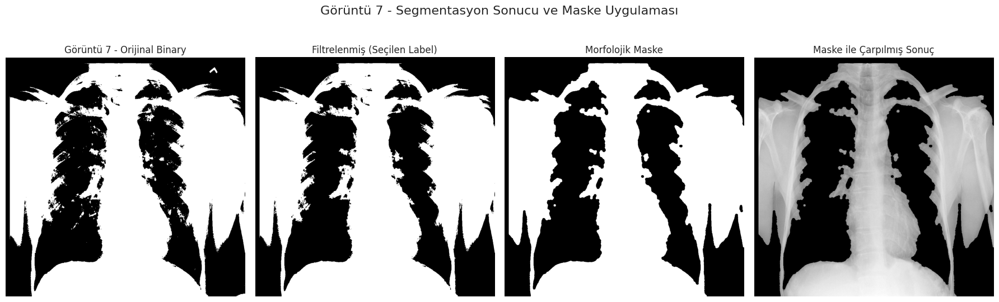


Görüntü 8 için Bölge Özellikleri:
Label:  1 | Area:    3 | Centroid: [  0. 356.] | Mean Intensity: 0.42 | Eccentricity: 1.00 | Solidity: 1.00
Label:  2 | Area: 632546 | Centroid: [570.95 501.83] | Mean Intensity: 0.52 | Eccentricity: 0.41 | Solidity: 0.62
Label:  3 | Area:    3 | Centroid: [  0. 771.] | Mean Intensity: 0.42 | Eccentricity: 1.00 | Solidity: 1.00
Label:  4 | Area:    1 | Centroid: [  0. 948.] | Mean Intensity: 0.42 | Eccentricity: 0.00 | Solidity: 1.00
Label:  5 | Area:    3 | Centroid: [  0. 952.] | Mean Intensity: 0.42 | Eccentricity: 1.00 | Solidity: 1.00
Label:  6 | Area:    5 | Centroid: [  0. 957.] | Mean Intensity: 0.43 | Eccentricity: 1.00 | Solidity: 1.00
Label:  7 | Area:   92 | Centroid: [5.90000e-01 1.00073e+03] | Mean Intensity: 0.47 | Eccentricity: 1.00 | Solidity: 0.42
Label:  8 | Area:    2 | Centroid: [ 13.5 374. ] | Mean Intensity: 0.42 | Eccentricity: 1.00 | Solidity: 1.00
Label:  9 | Area:    6 | Centroid: [ 16.67 373.5 ] | Mean Intensity: 0.42 | Ecc

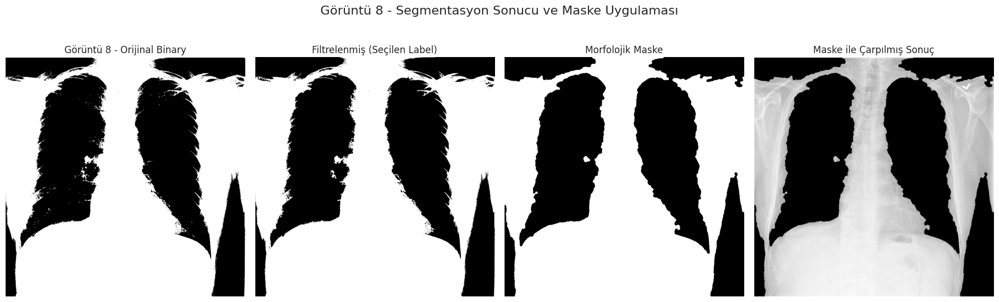

In [39]:

for i in range(9):
    # 1. Görüntüyü Yükleme ve Gri Tonlama
    sample_img = train_df.Image[i]
    image = plt.imread(os.path.join(img_dir, sample_img))
    if image.ndim == 3:
        image = color.rgb2gray(image)

    # 2. Otsu Eşikleme ile Binary Görüntü Oluşturma
    otsu_thresh = filters.threshold_otsu(image)
    binary_image = image > otsu_thresh

    # 3. Bağlantı Bileşen Analizi (Labeling)
    labels = measure.label(binary_image, connectivity=2)

    # 4. Bölge (Region) Özelliklerini Hesaplama
    regions = regionprops(labels, intensity_image=image)

    print(f"\nGörüntü {i} için Bölge Özellikleri:")
    for region in regions:
        # En az 5 öznitelik: Label, Area, Centroid, Mean Intensity, Eccentricity, Solidity
        print(f"Label: {int(region.label):2d} | Area: {int(region.area):4d} | Centroid: {np.round(region.centroid, 2)} | "
              f"Mean Intensity: {region.mean_intensity:.2f} | "
              f"Eccentricity: {region.eccentricity:.2f} | Solidity: {region.solidity:.2f}")

    # 5. Akciğer Alanlarını Temsil Eden Bölge(ler) Seçimi
    height, width = image.shape
    center_x = width / 2.0  # yatay merkez
    regions_sorted = sorted(regions, key=lambda r: r.area, reverse=True)

    selected_labels = []
    if len(regions_sorted) >= 2:
        r1 = regions_sorted[0]
        r2 = regions_sorted[1]
        if abs(r1.centroid[1] - center_x) < width * 0.2 and abs(r2.centroid[1] - center_x) < width * 0.2:
            selected_labels = [r1.label, r2.label]
        else:
            selected_labels = [r1.label]
    elif regions_sorted:
        selected_labels = [regions_sorted[0].label]
    else:
        print("Hiçbir bölge tespit edilemedi!")

    print(f"Seçilen Label(lar): {selected_labels}")

    # 6. Filtrelenmiş Görüntüyü Oluşturma: Sadece seçilen label'lara ait bölgeleri koruyoruz.
    filtered_image = np.isin(labels, selected_labels)

    # 7. Morfolojik İşlemler:
    selem = morphology.disk(5)
    morph_image = morphology.opening(filtered_image, selem)
    morph_image = morphology.closing(morph_image, selem)

    # 8. Maske ile Orijinal Görüntüyü Çarpma
    # Burada orijinal gri tonlamalı görüntü ile morfolojik işlemler sonrası elde ettiğimiz maskeyi çarpıyoruz.
    # Bu sayede sadece seçilen bölgelerin orijinal yoğunluk değerleri korunur.
    masked_image = image * morph_image

    # 9. Sonuçların Görselleştirilmesi
    plt.figure(figsize=(18, 6))

    # Orijinal Binary Görüntü (Otsu ile elde edilen)
    plt.subplot(1, 4, 1)
    plt.imshow(binary_image, cmap='gray')
    plt.title(f"Görüntü {i} - Orijinal Binary")
    plt.axis('off')

    # Filtrelenmiş (Seçilen Label) Görüntü
    plt.subplot(1, 4, 2)
    plt.imshow(filtered_image, cmap='gray')
    plt.title("Filtrelenmiş (Seçilen Label)")
    plt.axis('off')

    # Morfolojik İşlemler Sonrası Maske
    plt.subplot(1, 4, 3)
    plt.imshow(morph_image, cmap='gray')
    plt.title("Morfolojik Maske")
    plt.axis('off')

    # Maske ile Çarpılmış Orijinal Görüntü
    plt.subplot(1, 4, 4)
    plt.imshow(masked_image, cmap='gray')
    plt.title("Maske ile Çarpılmış Sonuç")
    plt.axis('off')

    plt.suptitle(f"Görüntü {i} - Segmentasyon Sonucu ve Maske Uygulaması", fontsize=16)
    plt.tight_layout()
    plt.show()
